<a href="https://colab.research.google.com/github/moons54/IA_P5/blob/main/P5_01_Notebook_Aurelien_MIMOUNI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PROJET P5 OPENCLASSROOM




___
Le 07 / 03/ 2021
Parcours : Ingenieur Intelligence Artificielle

## Partie I :  Présentation  numérique  des données
* * *


Cette première partie à pour objectif de mieux présenter les données 

Nous allons dans un premier temps détailler les interactions entre les différentes base de donnée. 

Dans un second temps, nous préparerons les données 

Pour notre première partie, nous allons procéder de la manières suivante : 


    1   Compréhension des problématiques métier
    2   Chargement et description des donnée
    3   Transformation du jeu de données
    


#### Librairies utilisées 
----


jeu de données | Ressources
----------------|---------------- |
pandas |  chargement et filtrage des données
numpy  | Opération de calcul  traitement notamment des NaN's, filtrage plus les conditions
matplotlib | for visualizations during exploration
seaborn | visulation des données
scipy | for hypothesis testing
scikit-learn | preprocessing et regression logistique
functions | methode pour analyse ACP





### 1. Comprehension des problématiques métiers

Votre objectif est de comprendre les différents types d’utilisateurs grâce à leur comportement et à leurs données personnelles.

Vous devrez fournir à l’équipe marketing une description actionable de votre segmentation et de sa logique sous-jacente pour une utilisation optimale, ainsi qu’une proposition de contrat de maintenance basée sur une analyse de la stabilité des segments au cours du temps.

### 2. Chargement et description des données

In [ ]:
# numpy and pandas for data manipulation
import numpy as np
import pandas as pd 
import math as math
# sklearn preprocessing for dealing with categorical variables
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn import preprocessing

# File system manangement
import os

# Suppress warnings 
import warnings
warnings.filterwarnings('ignore')

# matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
import seaborn as sns


from sklearn import decomposition
from sklearn import preprocessing


import folium
from folium.features import DivIcon
from mpl_toolkits.mplot3d import Axes3D

# Outlier detection
from sklearn.ensemble import IsolationForest

# Save objects
import joblib


# Data table display for Pandas dataframes
from google.colab import data_table
%load_ext google.colab.data_table

import plotly.express as px

# machine learning
from sklearn import decomposition
from sklearn import preprocessing

from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.metrics import confusion_matrix

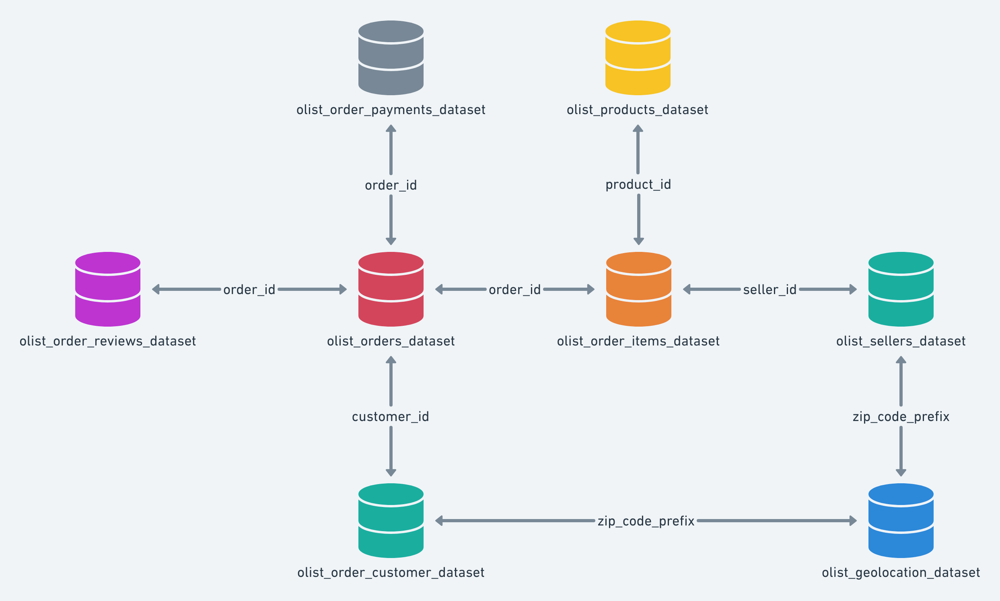

In [ ]:
#repertoire courant
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
sellers = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_sellers_dataset.csv')
print('Training data shape: ', sellers.shape)

Training data shape:  (3095, 4)


In [ ]:
sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
products = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_products_dataset.csv')
print('Training data shape: ', products.shape)

Training data shape:  (32951, 9)


In [ ]:
products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
orders = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_orders_dataset.csv')
print('Training data shape: ', orders.shape)

Training data shape:  (99441, 8)


In [ ]:
orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
order_reviews = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_order_reviews_dataset.csv')
print('Training data shape: ', order_reviews.shape)

Training data shape:  (100000, 7)


In [ ]:
order_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
payments_order = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_order_payments_dataset.csv')
print('Training data shape: ', payments_order.shape)

Training data shape:  (103886, 5)


In [ ]:
payments_order.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
orders_items = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_order_items_dataset.csv')
print('Training data shape: ', orders_items.shape)

Training data shape:  (112650, 7)


In [ ]:
orders_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
geolocation = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_geolocation_dataset.csv')
print('Training data shape: ', geolocation.shape)

Training data shape:  (1000163, 5)


In [ ]:
geolocation.duplicated(['geolocation_zip_code_prefix']).sum()

981148

In [ ]:
geolocationNoduplicated= geolocation.drop_duplicates(['geolocation_zip_code_prefix','geolocation_city'],keep="first")

In [ ]:
geolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
customers = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/olist_customers_dataset.csv')
print('Training data shape: ', customers.shape)

Training data shape:  (99441, 5)


In [ ]:
customers.head()


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
product_name_cat = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/product_category_name_translation.csv')
print('Training data shape: ', product_name_cat.shape)

Training data shape:  (71, 2)


In [ ]:
product_name_cat.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [ ]:
table_segmentation = orders

### 3. Transformation du jeu de données



#### Préparation et formatage des differents dataset 

Nous convertissons les champs objet contenant des dates en dates
et requalifions les catégories

In [ ]:
customers['customer_zip_code_prefix'] = \
  customers['customer_zip_code_prefix'].astype('category')

geolocation['geolocation_zip_code_prefix'] = \
  geolocation['geolocation_zip_code_prefix'].astype('category')

sellers['seller_zip_code_prefix'] = \
  sellers['seller_zip_code_prefix'].astype('category')

order_reviews['review_answer_timestamp'] = \
  order_reviews['review_answer_timestamp'].astype('datetime64')

order_reviews['review_creation_date'] = \
  order_reviews['review_creation_date'].astype('datetime64')

orders_items['shipping_limit_date'] = \
  orders_items['shipping_limit_date'].astype('datetime64')

orders['order_approved_at'] = \
  orders['order_approved_at'].astype('datetime64')

orders['order_delivered_carrier_date'] = \
  orders['order_delivered_carrier_date'].astype('datetime64')

orders['order_delivered_customer_date'] = \
  orders['order_delivered_customer_date'].astype('datetime64')

orders['order_estimated_delivery_date'] = \
  orders['order_estimated_delivery_date'].astype('datetime64')

orders['order_purchase_timestamp'] = \
  orders['order_purchase_timestamp'].astype('datetime64')


In [ ]:
order_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01,2018-03-02 10:26:53


#### fusion des dataframes


Etape 1 : fusion order customer et situation GPS

-  Nous avons utilisé en amont la méthode dropduplicater sur la geolocalisation afin de ne pas avoir des doublons

In [ ]:
dmcustomer = pd.merge( customers,geolocationNoduplicated,how="left",left_on=['customer_zip_code_prefix','customer_city'], right_on=['geolocation_zip_code_prefix','geolocation_city'])

Etape 2 : fusion paiment order  et liste des commandes

Nous avons utilisé en amont la methode dropduplicater sur la geolocalisation afin de ne pas avoir des doublons


In [ ]:
dmorder = pd.merge( payments_order,orders,how="left",left_on="order_id", right_on="order_id")

Etape 3 : Fusion entre order customer et liste des commandes 

In [ ]:
dm9 = pd.merge( dmorder,dmcustomer,how="left",left_on="customer_id", right_on="customer_id")

Etape 4 : Fusion entre liste ordre  et liste des produits


In [ ]:
dm8 = pd.merge( products,orders_items,how="left",left_on="product_id", right_on="product_id")

Etape 5 : Fusion entre liste ordre  et liste des produits


In [ ]:
dm7 = pd.merge(product_name_cat,dm8,how="left",left_on="product_category_name", right_on="product_category_name" )

Etape 6 : fusion entre le tableau principale et liste des produits

In [ ]:
tableau_principal = pd.merge( dm7,dm9,how="left",left_on="order_id", right_on="order_id")

Etape 7 : fusion commentaire du client et tableau de bord


In [ ]:
dm0 = pd.merge( order_reviews,tableau_principal,how="left",left_on="order_id", right_on="order_id")

In [ ]:
dm0.columns

Index(['review_id', 'order_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_category_name_english', 'product_id', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'order_item_id', 'seller_id', 'shipping_limit_date', 'price',
       'freight_value', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'customer_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'geolocation_city', 'geolocation_s

Etape 8 : Fusion revendeur et tableau de bord


In [ ]:
dm1 = pd.merge( sellers,dm0,how="left",left_on="seller_id", right_on="seller_id")

création de la table final en repositionnant les colonnes a utiliser et en supprimant les colonnes inutiles tels que XXX_id

In [ ]:
dm1.columns

Index(['seller_id', 'seller_zip_code_prefix', 'seller_city', 'seller_state',
       'review_id', 'order_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_category_name_english', 'product_id', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'order_item_id', 'shipping_limit_date', 'price', 'freight_value',
       'payment_sequential', 'payment_type', 'payment_installments',
       'payment_value', 'customer_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'geolocation_zip_code_prefix', 'geolocation_la

In [ ]:
table_segmentation = dm1[['customer_unique_id','order_id','seller_id','customer_id','product_category_name_english',
       'product_name_lenght', 'product_description_lenght','product_photos_qty','product_id',
        'product_weight_g', 'product_length_cm', 'product_height_cm',
        'product_width_cm','seller_city','seller_state','shipping_limit_date', 
        'price','payment_value','payment_sequential', 'payment_type',
        'payment_installments','freight_value', 'review_score','order_status','order_delivered_customer_date',
        'order_purchase_timestamp','order_estimated_delivery_date','order_approved_at','order_delivered_carrier_date',
        'customer_city','customer_state', 'geolocation_lat', 'geolocation_lng']]

In [ ]:
table_segmentation.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 116646 entries, 0 to 116645
Data columns (total 33 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   customer_unique_id             116581 non-null  object        
 1   order_id                       116584 non-null  object        
 2   seller_id                      116646 non-null  object        
 3   customer_id                    116581 non-null  object        
 4   product_category_name_english  116584 non-null  object        
 5   product_name_lenght            116584 non-null  float64       
 6   product_description_lenght     116584 non-null  float64       
 7   product_photos_qty             116584 non-null  float64       
 8   product_id                     116584 non-null  object        
 9   product_weight_g               116583 non-null  float64       
 10  product_length_cm              116583 non-null  float64       
 11  

In [ ]:
#table_segmentation.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
table_segmentation.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege.csv')

#### Transformation complémentaire :
(Amélioration featuring )



- ciblage des transactions uniquement delivrés
----


In [ ]:
table_segmentation = table_segmentation.loc[table_segmentation['order_status'] == 'delivered']


- remplacement des observations dont la date de livraison est vide par valeur moyenne du dataframe 
---


In [ ]:
table_segmentation['order_delivered_customer_date'].fillna(
    table_segmentation['order_delivered_customer_date'].mean(), 
    inplace=True)

- ajout d'une colonne 'order_time' afin de connaitre le nombre de commande dans le temps
---

In [ ]:
table_segmentation['order_time'] = table_segmentation['order_delivered_customer_date'] -\
                             table_segmentation['order_purchase_timestamp']

table_segmentation['order_time'] = table_segmentation['order_time'].apply(lambda x: x.days)


- ajout d'une colonne 'estimated_order_time' afin de comparer avec la colonne order time
---

In [ ]:
table_segmentation['estimated_order_time'] =table_segmentation['order_estimated_delivery_date'] -\
                             table_segmentation['order_purchase_timestamp']

table_segmentation['estimated_order_time'] = table_segmentation['estimated_order_time'].apply(lambda x: x.days) 


- ajout d'une colonne 'order_time_error_prct' l'objectif etant d'obtenir une notation entre le la date de delivrance et la date de reception estimée puis de le rapporter sous forme d'un pourcentage.
---

In [ ]:
table_segmentation['order_time_error_prct'] = table_segmentation['order_time'] - table_segmentation['estimated_order_time']

table_segmentation['order_time_error_prct'] = table_segmentation['order_time_error_prct'] * 100 / (
    table_segmentation['estimated_order_time'])

- suppression des colonnes inutiles

In [ ]:
table_segmentation= table_segmentation.drop(['order_approved_at', 'order_delivered_carrier_date',
              'order_delivered_customer_date', 'order_status'], axis=1)

In [ ]:
# I rename feature seller_id to favourite_seller
table_segmentation = table_segmentation.rename(columns={'seller_id': 'favourite_seller'})

In [ ]:
table_segmentation.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_transfo.csv')

In [ ]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
#table_segmentation = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_transfo.csv',delimiter=',')

In [ ]:
from google.colab import data_table

In [ ]:
table_segmentation

,customer_unique_id,order_id,favourite_seller,customer_id,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_id,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,shipping_limit_date,price,payment_value,payment_sequential,payment_type,payment_installments,freight_value,review_score,order_purchase_timestamp,order_estimated_delivery_date,customer_city,customer_state,geolocation_lat,geolocation_lng,order_time,estimated_order_time,order_time_error_prct,first_purchase_date,avg_basket_size
0,f421a2a66b69dbfe6db0c87845281a90,4a90af3e85dd563884e2afeab1091394,3442f8959a84dea7ee197c632cb2df15,9d6837f9700a3441e7183bff3bc4eef0,sports_leisure,26.0,417.0,3.0,ffb64e34a37740dafb6c88f1abd1fa61,700.0,43.0,15.0,35.0,campinas,SP,2017-08-25 20:50:19,106.2,115.76,1.0,credit_card,2.0,9.56,5.0,2017-08-21 20:35:44,2017-09-01,sao paulo,SP,-23.667671,-46.677754,8,10,-20.000000,2017-08-21 20:35:44,1
1,af0f26435fade1ca984d9affda307199,bc8a5de6abf5b14f98a6135a7fb46731,3442f8959a84dea7ee197c632cb2df15,1554ffe702931a062b4383b109accf63,sports_leisure,44.0,1089.0,1.0,325a06bcce0da45b7f4ecf2797dd40e4,300.0,16.0,5.0,15.0,campinas,SP,2017-09-05 12:50:19,10.8,158.80,1.0,credit_card,4.0,2.42,3.0,2017-08-30 11:47:52,2017-09-20,maua,SP,-23.675178,-46.449833,2,20,-90.000000,2017-08-30 11:47:52,2
2,b4527423469300ee354458e1b5f961be,6d953888a914b67350d5bc4d48f2acab,3442f8959a84dea7ee197c632cb2df15,a973c4e3ad82777add3fa188f91dacea,sports_leisure,27.0,485.0,2.0,f4621f8ad6f54a2e3c408884068be46d,600.0,35.0,15.0,28.0,campinas,SP,2017-05-11 16:25:11,101.7,117.62,1.0,credit_card,2.0,15.92,1.0,2017-05-05 16:12:29,2017-05-30,contagem,MG,-19.961706,-44.035239,28,24,16.666667,2017-05-05 16:12:29,1
3,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,d1b65fc7debc3361ea86b5f14c68d2e2,a0ef745a0553f2dc5b4d820405bb5f5a,luggage_accessories,24.0,513.0,5.0,41797ff66598803fa9ac0480e2ab3bc2,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.9,128.44,2.0,voucher,1.0,96.70,5.0,2017-06-07 09:31:57,2017-07-13,porto velho,RO,-8.791929,-63.893810,26,35,-25.714286,2017-06-07 09:31:57,2
4,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,d1b65fc7debc3361ea86b5f14c68d2e2,a0ef745a0553f2dc5b4d820405bb5f5a,luggage_accessories,24.0,513.0,5.0,41797ff66598803fa9ac0480e2ab3bc2,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.9,238.16,1.0,credit_card,6.0,96.70,5.0,2017-06-07 09:31:57,2017-07-13,porto velho,RO,-8.791929,-63.893810,26,35,-25.714286,2017-06-07 09:31:57,2


In [ ]:
table_segmentation['first_purchase_date'] = table_segmentation['order_purchase_timestamp']

In [ ]:
table_segmentation.fillna(value={'payment_type': 'credit_card',
                 'payment_installments': 1},
          inplace=True)


In [ ]:
df_product = pd.merge(table_segmentation,
                      orders_items[['order_id', 'product_id']],
                      how='left')

basket_size_order = df_product.groupby(
    'order_id').count()['product_id'].reset_index()

basket_size_order = basket_size_order.rename(
    columns={'product_id': 'avg_basket_size'})

table_segmentation = pd.merge(table_segmentation,
              basket_size_order,
              how='left') 

In [ ]:
# I rename feature seller_id to favourite_seller
table_segmentation = table_segmentation.rename(columns={'seller_id': 'favourite_seller'})

In [ ]:
table_segmentation.isna().sum()

customer_unique_id                 0
order_id                           0
favourite_seller                   0
customer_id                        0
product_category_name_english      0
product_name_lenght                0
product_description_lenght         0
product_photos_qty                 0
product_id                         0
product_weight_g                   1
product_length_cm                  1
product_height_cm                  1
product_width_cm                   1
seller_city                        0
seller_state                       0
shipping_limit_date                0
price                              0
payment_value                      0
payment_sequential                 0
payment_type                       0
payment_installments               0
freight_value                      0
review_score                       0
order_purchase_timestamp           0
order_estimated_delivery_date      0
customer_city                      0
customer_state                     0
g

In [ ]:
#table_segmentation.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege.csv')

## Partie II : Exploration des données

Visualisation des données 


- les variables qualitatives
- les variables quantitatives
- Analyse de données nan
- Visualisation des données abérrantes - outliers
Relation entre les variables


In [ ]:
from google.colab import data_table
data_table.DataTable(table_segmentation, include_index=False, num_rows_per_page=10)

,customer_unique_id,order_id,favourite_seller,customer_id,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_id,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,shipping_limit_date,price,payment_value,payment_sequential,payment_type,payment_installments,freight_value,review_score,order_purchase_timestamp,order_estimated_delivery_date,customer_city,customer_state,geolocation_lat,geolocation_lng,order_time,estimated_order_time,order_time_error_prct,first_purchase_date,avg_basket_size
0,f421a2a66b69dbfe6db0c87845281a90,4a90af3e85dd563884e2afeab1091394,3442f8959a84dea7ee197c632cb2df15,9d6837f9700a3441e7183bff3bc4eef0,sports_leisure,26.0,417.0,3.0,ffb64e34a37740dafb6c88f1abd1fa61,700.0,43.0,15.0,35.0,campinas,SP,2017-08-25 20:50:19,106.20,115.76,1.0,credit_card,2.0,9.56,5.0,2017-08-21 20:35:44,2017-09-01,sao paulo,SP,-23.667671,-46.677754,8,10,-20.000000,2017-08-21 20:35:44,1
1,af0f26435fade1ca984d9affda307199,bc8a5de6abf5b14f98a6135a7fb46731,3442f8959a84dea7ee197c632cb2df15,1554ffe702931a062b4383b109accf63,sports_leisure,44.0,1089.0,1.0,325a06bcce0da45b7f4ecf2797dd40e4,300.0,16.0,5.0,15.0,campinas,SP,2017-09-05 12:50:19,10.80,158.80,1.0,credit_card,4.0,2.42,3.0,2017-08-30 11:47:52,2017-09-20,maua,SP,-23.675178,-46.449833,2,20,-90.000000,2017-08-30 11:47:52,2
2,b4527423469300ee354458e1b5f961be,6d953888a914b67350d5bc4d48f2acab,3442f8959a84dea7ee197c632cb2df15,a973c4e3ad82777add3fa188f91dacea,sports_leisure,27.0,485.0,2.0,f4621f8ad6f54a2e3c408884068be46d,600.0,35.0,15.0,28.0,campinas,SP,2017-05-11 16:25:11,101.70,117.62,1.0,credit_card,2.0,15.92,1.0,2017-05-05 16:12:29,2017-05-30,contagem,MG,-19.961706,-44.035239,28,24,16.666667,2017-05-05 16:12:29,1
3,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,d1b65fc7debc3361ea86b5f14c68d2e2,a0ef745a0553f2dc5b4d820405bb5f5a,luggage_accessories,24.0,513.0,5.0,41797ff66598803fa9ac0480e2ab3bc2,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.90,128.44,2.0,voucher,1.0,96.70,5.0,2017-06-07 09:31:57,2017-07-13,porto velho,RO,-8.791929,-63.893810,26,35,-25.714286,2017-06-07 09:31:57,2
4,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,d1b65fc7debc3361ea86b5f14c68d2e2,a0ef745a0553f2dc5b4d820405bb5f5a,luggage_accessories,24.0,513.0,5.0,41797ff66598803fa9ac0480e2ab3bc2,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.90,238.16,1.0,credit_card,6.0,96.70,5.0,2017-06-07 09:31:57,2017-07-13,porto velho,RO,-8.791929,-63.893810,26,35,-25.714286,2017-06-07 09:31:57,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114062,7b0662b2bc6c7ed0097a51f9aefb376a,deea565ebe3196a7408232c8bb0ddc0b,74871d19219c7d518d0090283e03c137,a028a12d1103e8eb0dcc7a1e12fdc1aa,sports_leisure,57.0,801.0,1.0,dab1da142d5a95b9200cef4675a3f9fa,1600.0,23.0,24.0,18.0,sao paulo,SP,2018-07-27 09:19:12,121.03,132.90,1.0,credit_card,1.0,11.87,5.0,2018-07-22 13:14:45,2018-08-02,sao paulo,SP,-23.525614,-46.700620,2,10,-80.000000,2018-07-22 13:14:45,1
114063,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,74871d19219c7d518d0090283e03c137,96abe7b6c735a2b8b72765a7e1ecd3e2,food_drink,54.0,1342.0,1.0,0a9dafcfb351b0dd0fafd06b8f842b55,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.00,82.46,1.0,credit_card,1.0,11.23,5.0,2018-07-30 18:33:10,2018-08-06,sao paulo,SP,-23.673153,-46.686683,2,6,-66.666667,2018-07-30 18:33:10,4
114064,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,74871d19219c7d518d0090283e03c137,96abe7b6c735a2b8b72765a7e1ecd3e2,food_drink,54.0,1342.0,1.0,0a9dafcfb351b0dd0fafd06b8f842b55,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.00,82.46,1.0,credit_card,1.0,11.23,5.0,2018-07-30 18:33:10,2018-08-06,sao paulo,SP,-23.673153,-46.686683,2,6,-66.666667,2018-07-30 18:33:10,4
114065,22534f67ddbf35d6831b4b0d4beea813,4dee2a3e6470bab984859192120d6e3e,7

In [ ]:
table_segmentation = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege.csv',parse_dates=['order_purchase_timestamp','fist_purchase_date'],dayfirst=True)

In [ ]:
#table_segmentation.drop('Unnamed: 0',axis=1,inplace=True)
table_segmentation

,customer_unique_id,order_id,favourite_seller,customer_id,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_id,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,shipping_limit_date,price,payment_value,payment_sequential,payment_type,payment_installments,freight_value,review_score,order_purchase_timestamp,order_estimated_delivery_date,customer_city,customer_state,geolocation_lat,geolocation_lng,order_time,estimated_order_time,order_time_error_prct,first_purchase_date,avg_basket_size
0,f421a2a66b69dbfe6db0c87845281a90,4a90af3e85dd563884e2afeab1091394,3442f8959a84dea7ee197c632cb2df15,9d6837f9700a3441e7183bff3bc4eef0,sports_leisure,26.0,417.0,3.0,ffb64e34a37740dafb6c88f1abd1fa61,700.0,43.0,15.0,35.0,campinas,SP,2017-08-25 20:50:19,106.20,115.76,1.0,credit_card,2.0,9.56,5.0,2017-08-21 20:35:44,2017-09-01,sao paulo,SP,-23.667671,-46.677754,8,10,-20.000000,2017-08-21 20:35:44,1
1,af0f26435fade1ca984d9affda307199,bc8a5de6abf5b14f98a6135a7fb46731,3442f8959a84dea7ee197c632cb2df15,1554ffe702931a062b4383b109accf63,sports_leisure,44.0,1089.0,1.0,325a06bcce0da45b7f4ecf2797dd40e4,300.0,16.0,5.0,15.0,campinas,SP,2017-09-05 12:50:19,10.80,158.80,1.0,credit_card,4.0,2.42,3.0,2017-08-30 11:47:52,2017-09-20,maua,SP,-23.675178,-46.449833,2,20,-90.000000,2017-08-30 11:47:52,2
2,b4527423469300ee354458e1b5f961be,6d953888a914b67350d5bc4d48f2acab,3442f8959a84dea7ee197c632cb2df15,a973c4e3ad82777add3fa188f91dacea,sports_leisure,27.0,485.0,2.0,f4621f8ad6f54a2e3c408884068be46d,600.0,35.0,15.0,28.0,campinas,SP,2017-05-11 16:25:11,101.70,117.62,1.0,credit_card,2.0,15.92,1.0,2017-05-05 16:12:29,2017-05-30,contagem,MG,-19.961706,-44.035239,28,24,16.666667,2017-05-05 16:12:29,1
3,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,d1b65fc7debc3361ea86b5f14c68d2e2,a0ef745a0553f2dc5b4d820405bb5f5a,luggage_accessories,24.0,513.0,5.0,41797ff66598803fa9ac0480e2ab3bc2,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.90,128.44,2.0,voucher,1.0,96.70,5.0,2017-06-07 09:31:57,2017-07-13,porto velho,RO,-8.791929,-63.893810,26,35,-25.714286,2017-06-07 09:31:57,2
4,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,d1b65fc7debc3361ea86b5f14c68d2e2,a0ef745a0553f2dc5b4d820405bb5f5a,luggage_accessories,24.0,513.0,5.0,41797ff66598803fa9ac0480e2ab3bc2,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.90,238.16,1.0,credit_card,6.0,96.70,5.0,2017-06-07 09:31:57,2017-07-13,porto velho,RO,-8.791929,-63.893810,26,35,-25.714286,2017-06-07 09:31:57,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114062,7b0662b2bc6c7ed0097a51f9aefb376a,deea565ebe3196a7408232c8bb0ddc0b,74871d19219c7d518d0090283e03c137,a028a12d1103e8eb0dcc7a1e12fdc1aa,sports_leisure,57.0,801.0,1.0,dab1da142d5a95b9200cef4675a3f9fa,1600.0,23.0,24.0,18.0,sao paulo,SP,2018-07-27 09:19:12,121.03,132.90,1.0,credit_card,1.0,11.87,5.0,2018-07-22 13:14:45,2018-08-02,sao paulo,SP,-23.525614,-46.700620,2,10,-80.000000,2018-07-22 13:14:45,1
114063,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,74871d19219c7d518d0090283e03c137,96abe7b6c735a2b8b72765a7e1ecd3e2,food_drink,54.0,1342.0,1.0,0a9dafcfb351b0dd0fafd06b8f842b55,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.00,82.46,1.0,credit_card,1.0,11.23,5.0,2018-07-30 18:33:10,2018-08-06,sao paulo,SP,-23.673153,-46.686683,2,6,-66.666667,2018-07-30 18:33:10,4
114064,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,74871d19219c7d518d0090283e03c137,96abe7b6c735a2b8b72765a7e1ecd3e2,food_drink,54.0,1342.0,1.0,0a9dafcfb351b0dd0fafd06b8f842b55,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.00,82.46,1.0,credit_card,1.0,11.23,5.0,2018-07-30 18:33:10,2018-08-06,sao paulo,SP,-23.673153,-46.686683,2,6,-66.666667,2018-07-30 18:33:10,4
114065,22534f67ddbf35d6831b4b0d4beea813,4dee2a3e6470bab984859192120d6e3e,7

In [ ]:
# I create df_volume
table_segmentation['avg_volume'] = table_segmentation['product_length_cm'] * \
                            table_segmentation['product_height_cm'] * \
                            table_segmentation['product_width_cm'] / 1000

In [ ]:


# I create an aggregation dictionnary
dict_agg = {
            'customer_city': 'first',
            'customer_state': 'first',
            'customer_id': 'count',
            'price': 'mean',
            'order_time': 'mean',
            'estimated_order_time': 'mean',
            'avg_basket_size': 'mean',
            'order_purchase_timestamp': 'max',
            'first_purchase_date': 'min',
            'review_score': 'mean',
            'geolocation_lat': 'mean',
            'geolocation_lng': 'mean',
            'order_time_error_prct': 'mean',
            'freight_value': 'mean',
            'favourite_seller': 'first',
            'payment_type': 'first',
            'payment_installments': 'first'
           }
           

In [ ]:
table_segmentation.fillna(table_segmentation.median(),inplace=True)

In [ ]:
# I group bu customer_unique_id then i aggragate with my dictionnary
table_segmentation1 = table_segmentation.groupby(['customer_unique_id',
                                                 'product_category_name_english',
                                                  'avg_volume'
                                                 ]).agg(dict_agg)

table_segmentation1 = table_segmentation1.reset_index()

table_segmentation1 = table_segmentation1.rename(columns={'customer_id': 'nbr_of_order'})

In [ ]:
table_segmentation1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97032 entries, 0 to 97031
Data columns (total 20 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   customer_unique_id             97032 non-null  object        
 1   product_category_name_english  97032 non-null  object        
 2   avg_volume                     97032 non-null  float64       
 3   customer_city                  97032 non-null  object        
 4   customer_state                 97032 non-null  object        
 5   nbr_of_order                   97032 non-null  int64         
 6   price                          97032 non-null  float64       
 7   order_time                     97032 non-null  float64       
 8   estimated_order_time           97032 non-null  float64       
 9   avg_basket_size                97032 non-null  float64       
 10  order_purchase_timestamp       97032 non-null  datetime64[ns]
 11  first_purchase_

In [ ]:
table_segmentation1.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege.csv')

In [ ]:
#table_segmentation = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege.csv',parse_dates=['order_purchase_timestamp','fist_purchase_date'],dayfirst=True)

In [ ]:
table_segmentation = table_segmentation1.copy()

In [ ]:
table_segmentation.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
print( "Dimension du jeu de données ", table_segmentation.shape)
print( "Nombre de feature ", table_segmentation.shape[1])
print("Nombre d'observation",  table_segmentation.shape[0])

Dimension du jeu de données  (97032, 20)
Nombre de feature  20
Nombre d'observation 97032


In [ ]:
table_segmentation.dtypes.value_counts()

float64           11
object             6
datetime64[ns]     2
int64              1
dtype: int64

- Variables qualitatives : 6 
- Variables quantitatives : 11


In [ ]:
table_segmentation.describe()

,avg_volume,nbr_of_order,price,order_time,estimated_order_time,avg_basket_size,review_score,geolocation_lat,geolocation_lng,order_time_error_prct,freight_value,payment_installments
count,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000,97032.000000
mean,15.214301,1.175561,124.723572,12.030924,23.414628,1.589426,4.119802,-21.212378,-46.192560,-47.554370,20.163403,2.954170
std,23.302932,0.698992,188.607689,9.638676,8.765615,3.740473,1.313029,5.608509,4.062907,39.744355,15.841512,2.743137
min,0.168000,1.000000,0.850000,-170.000000,2.000000,1.000000,1.000000,-36.605374,-72.666706,-958.823529,0.000000,0.000000
25%,2.816000,1.000000,41.790000,6.000000,18.000000,1.000000,4.000000,-23.588182,-48.105197,-70.000000,13.220000,1.000000
50%,6.450000,1.000000,79.000000,10.000000,23.000000,1.000000,5.000000,-22.929128,-46.631962,-56.250000,16.390000,2.000000
75%,18.400000,1.000000,139.200000,15.000000,28.000000,1.000000,5.000000,-20.175129,-43.653830,-36.363636,21.280000,4.000000
max,296.208000,42.000000,6735.000000,232.000000,155.000000,400.000000,5.000000,42.428884,-6.873344,1246.153846,409.680000,24.000000


### calcul de l'étendu date d'achat premiere et derniere date

In [ ]:
print('la date du dernier achat',max(table_segmentation['order_purchase_timestamp']),
      'et le premier', min(table_segmentation['order_purchase_timestamp']))

la date du dernier achat 2018-08-29 15:00:37 et le premier 2016-10-03 09:44:50


In [ ]:
table_segmentation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97032 entries, 0 to 97031
Data columns (total 20 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   customer_unique_id             97032 non-null  object        
 1   product_category_name_english  97032 non-null  object        
 2   avg_volume                     97032 non-null  float64       
 3   customer_city                  97032 non-null  object        
 4   customer_state                 97032 non-null  object        
 5   nbr_of_order                   97032 non-null  int64         
 6   price                          97032 non-null  float64       
 7   order_time                     97032 non-null  float64       
 8   estimated_order_time           97032 non-null  float64       
 9   avg_basket_size                97032 non-null  float64       
 10  order_purchase_timestamp       97032 non-null  datetime64[ns]
 11  first_purchase_

In [ ]:
table_segmentation['days_since_purchase'] = max(
    table_segmentation['order_purchase_timestamp']) - table_segmentation['order_purchase_timestamp']

table_segmentation['days_since_purchase'] = table_segmentation['days_since_purchase'].apply(lambda x: x.days)

#### visualisation du nombre de client/jour ayant effectué une commande

In [ ]:
# I copy table_segmentation
df_day = table_segmentation.copy()

In [ ]:
# I roud date by days
df_day['order_purchase_timestamp'] = (
    df_day['order_purchase_timestamp']).round('D')

In [ ]:
df_day = df_day.groupby(
    'order_purchase_timestamp').count()['customer_unique_id'].reset_index()

In [ ]:
df_day.head()

,order_purchase_timestamp,customer_unique_id
0,2016-10-03,1
1,2016-10-04,11
2,2016-10-05,61
3,2016-10-06,39
4,2016-10-07,45


In [ ]:
import plotly.express as px
fig = px.line(df_day, x='order_purchase_timestamp', 
              y='customer_unique_id', 
              range_x=['2017-01-01 00:00:00', df_day['order_purchase_timestamp'].max()], title="Nombre de client par jour")

fig.show()

In [ ]:
table_segmentation = table_segmentation.fillna(table_segmentation.median())

In [ ]:
table_segmentation

,customer_unique_id,product_category_name_english,avg_volume,customer_city,customer_state,nbr_of_order,price,order_time,estimated_order_time,avg_basket_size,order_purchase_timestamp,first_purchase_date,review_score,geolocation_lat,geolocation_lng,order_time_error_prct,freight_value,favourite_seller,payment_type,payment_installments,days_since_purchase
0,0000366f3b9a7992bf8c76cfdf3221e2,bed_bath_table,7.616,cajamar,SP,1,129.90,6.0,10.0,1.0,2018-05-10 10:56:27,2018-05-10 10:56:27,5.0,-23.335331,-46.828647,-40.000000,12.00,da8622b14eb17ae2831f4ac5b9dab84a,credit_card,8.0,111
1,0000b849f77a49e4a4ce2b2a4ca5be3f,health_beauty,5.148,osasco,SP,1,18.90,3.0,7.0,1.0,2018-05-07 11:11:27,2018-05-07 11:11:27,4.0,-23.567395,-46.792957,-57.142857,8.29,138dbe45fc62f1e244378131a6801526,credit_card,1.0,114
2,0000f46a3911fa3c0805444483337064,stationery,43.750,sao jose,SC,1,69.00,25.0,27.0,1.0,2017-03-10 21:05:03,2017-03-10 21:05:03,3.0,-27.543787,-48.625680,-7.407407,17.22,3d871de0142ce09b7081e2b9d1733cb1,credit_card,8.0,536
3,0000f6ccb0745a6a4b88665a16c9f078,telephony,1.045,belem,PA,1,25.99,20.0,31.0,1.0,2017-10-12 20:29:41,2017-10-12 20:29:41,4.0,-1.311011,-48.482884,-35.483871,17.63,ef506c96320abeedfb894c34db06f478,credit_card,4.0,320
4,0004aac84e0df4da2b147fca70cf8255,telephony,0.528,sorocaba,SP,1,180.00,13.0,20.0,1.0,2017-11-14 19:45:42,2017-11-14 19:45:42,5.0,-23.504368,-47.466156,-35.000000,16.89,70a12e78e608ac31179aea7f8422044b,credit_card,6.0,287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97027,fffcf5a5ff07b0908bd4e2dbc735a684,health_beauty,251.625,sanharo,PE,2,785.00,27.0,54.0,2.0,2017-06-08 21:00:36,2017-06-08 21:00:36,5.0,-8.363166,-36.559088,-50.000000,248.71,17f51e7198701186712e53a39c564617,credit_card,10.0,446
97028,fffea47cd6d3cc0a88bd621562a9d061,baby,32.076,feira de santana,BA,1,64.89,30.0,32.0,1.0,2017-12-10 20:07:56,2017-12-10 20:07:56,4.0,-12.221792,-38.962517,-6.250000,19.69,7aa4334be125fcdd2ba64b3180029f14,credit_card,1.0,261
97029,ffff371b4d645b6ecea244b27531430a,auto,3.315,sinop,MT,1,89.90,14.0,44.0,1.0,2017-02-07 15:49:16,2017-02-07 15:49:16,5.0,-11.829317,-55.496443,-68.181818,22.56,54aa8463e87776b5612f4bdc4bd5d4de,credit_card,1.0,567
97030,ffff5962728ec6157033ef9805bacc48,watches_gifts,4.480,bom jesus do norte,ES,1,115.00,11.0,25.0,1.0,2018-05-02 15:17:41,2018-05-02 15:17:41,5.0,-21.125061,-41.666268,-56.000000,18.69,7d13fca15225358621be4086e1eb0964,credit_card,5.0,118


In [ ]:
#table_segmentation['first_purchase_date'] = table_segmentation['fist_purchase_date']

In [ ]:
table_segmentation['time_between'] = (table_segmentation['order_purchase_timestamp'] - \
                      table_segmentation['first_purchase_date']) / (table_segmentation['nbr_of_order'] - 1)

table_segmentation['time_between'] = table_segmentation['time_between'].apply(lambda x: x.days)

table_segmentation = table_segmentation.drop('first_purchase_date', axis=1)
table_segmentation = table_segmentation.drop('order_purchase_timestamp', axis=1)

In [ ]:
table_segmentation.loc[table_segmentation['time_between'].isna(), 'time_between'] = 0

Analyse des données manquantes

In [ ]:
table_segmentation.isna().sum()

customer_unique_id               0
product_category_name_english    0
avg_volume                       0
customer_city                    0
customer_state                   0
nbr_of_order                     0
price                            0
order_time                       0
estimated_order_time             0
avg_basket_size                  0
review_score                     0
geolocation_lat                  0
geolocation_lng                  0
order_time_error_prct            0
freight_value                    0
favourite_seller                 0
payment_type                     0
payment_installments             0
days_since_purchase              0
time_between                     0
dtype: int64

In [ ]:
table_segmentation.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_withoutNan.csv')

### Les variables quantitatives
___

- 0n constate que 7 variables commençant par *product_* donne des caractéristiques du produit ( taille, poid, longueur, largeur, nombre de photo)
 ( hauteur , largeur, longueur sont en cm et poid en gramme, quantité de photo en nombre) 
- On constate que 3 variables commençant par *payment_* caractérise la transaction de paiement
- On constate que 4 variables commencant par *geolo* caractérise la situation géographique entre le vendeur et le consommateur
- On retrouve une catégorie review_score qui semble correspondre a la notation du client de son ressenti sur la transaction et achat. ( il s'agit d'un nombre numérique compris entre 1 et 5  


In [ ]:
tble_float =table_segmentation.select_dtypes('float').info()
#table_segmentation.drop('Unnamed: 0',axis=1,inplace=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97032 entries, 0 to 97031
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   avg_volume             97032 non-null  float64
 1   price                  97032 non-null  float64
 2   order_time             97032 non-null  float64
 3   estimated_order_time   97032 non-null  float64
 4   avg_basket_size        97032 non-null  float64
 5   review_score           97032 non-null  float64
 6   geolocation_lat        97032 non-null  float64
 7   geolocation_lng        97032 non-null  float64
 8   order_time_error_prct  97032 non-null  float64
 9   freight_value          97032 non-null  float64
 10  payment_installments   97032 non-null  float64
 11  time_between           97032 non-null  float64
dtypes: float64(12)
memory usage: 8.9 MB


On constate que les variables semblent suivre une distribution de type linéaire.

In [ ]:
#tble_float.describe().transpose()

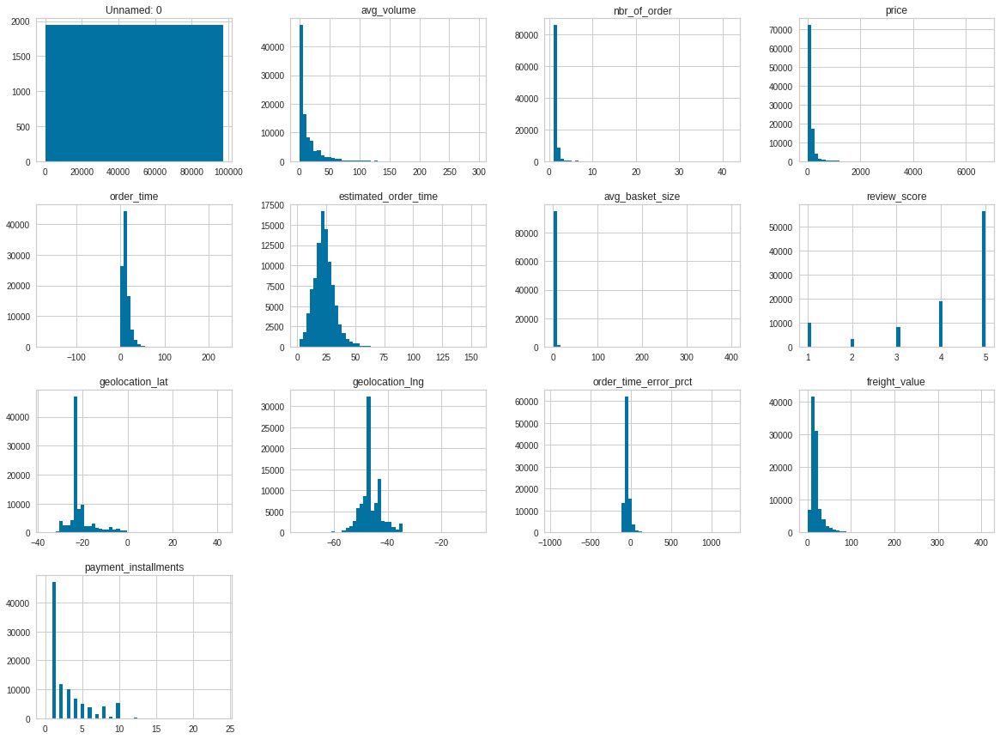

In [ ]:
table_segmentation.hist(bins=50, figsize=(20,15))
plt.show()

### Les variables qualitatives
___

- 2 variables qualitatives ont moins de 10 catégories. (order_status, payment_type). concerne principalement le mode de paiement
- 3 variables qualitatives sont comprise entre 20 et 100 catégories ( seller_state, customer_state, product_category_name_english). on constate que deux concernent le code de l'etat du consommateur et du revendeur. la variable product_category concerne le nom de la catégorie.

- 6 variables representant des dates. 
concerne le détail dans le temps de la transaction 
( de la commande et la livraison finale chez le consommateur) shipping_limit_date,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date.



In [ ]:
echantillon_objet =table_segmentation.select_dtypes('object')

In [ ]:
for col in echantillon_objet:
    print(col, echantillon_objet[col].duplicated().value_counts())
    print(echantillon_objet[col].value_counts().unique())
   

customer_unique_id False    94088
True     22558
Name: customer_unique_id, dtype: int64
[75 38 35 29 26 24 22 21 20 19 18 16 15 14 13 12 11 10  9  8  7  6  5  4
  3  2  1]
product_category_name_english True     116574
False        72
Name: product_category_name_english, dtype: int64
[11990 10033  9005  8833  8151  7380  6213  4726  4590  4400  4281  3999
  3589  3204  2847  2625  2170  2030  1788  1192  1163   955   826   719
   705   635   565   532   526   478   390   381   332   314   302   299
   291   278   272   271   252   247   220   219   201   199   155   145
   144   126   105    87    78    74    71    62    50    46    41    40
    39    33    31    24    16    14     8     2]
seller_city True     116035
False       611
Name: seller_city, dtype: int64
[29071  8333  3147  3132  2687  2610  2467  2351  2291  2070  2022  1761
  1454  1397  1371  1255  1186  1171   982   899   876   874   836   829
   808   746   721   667   632   628   619   613   560   558   553   550
   508

In [ ]:
echantillon_objet.describe().transpose()

,count,unique,top,freq
customer_unique_id,116581,94087,9a736b248f67d166d2fbb006bcb877c3,75
product_category_name_english,116584,71,bed_bath_table,11990
seller_city,116646,611,sao paulo,29071
seller_state,116646,23,SP,83161
shipping_limit_date,116584,92053,2017-08-14 20:43:31,63
payment_type,116581,4,credit_card,86012
order_status,116581,7,delivered,114067
order_purchase_timestamp,116581,96720,2017-08-08 20:26:31,63
order_approved_at,116567,88963,2017-08-08 20:43:31,63
order_delivered_carrier_date,115368,79801,2017-08-10 11:58:14,63


### Les valeurs manquantes (nan)
____
le taux de variable manquante est tres faible.

In [ ]:
for col in table_segmentation.columns:
    pct_missing = np.mean(table_segmentation[col].isna())
    print('{:-<50} - {}%'.format(col, round(pct_missing*100)))

Unnamed: 0---------------------------------------- - 0%
customer_unique_id-------------------------------- - 0%
product_category_name_english--------------------- - 0%
avg_volume---------------------------------------- - 0%
customer_city------------------------------------- - 0%
customer_state------------------------------------ - 0%
nbr_of_order-------------------------------------- - 0%
price--------------------------------------------- - 0%
order_time---------------------------------------- - 0%
estimated_order_time------------------------------ - 0%
avg_basket_size----------------------------------- - 0%
order_purchase_timestamp-------------------------- - 0%
fist_purchase_date-------------------------------- - 0%
review_score-------------------------------------- - 0%
geolocation_lat----------------------------------- - 0%
geolocation_lng----------------------------------- - 0%
order_time_error_prct----------------------------- - 0%
freight_value-----------------------------------

### Traitement des outliers 

In [ ]:
#table_segmentation1.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_avt_traitement_outlier.csv')

In [ ]:
table_segmentation = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege.csv',parse_dates=['order_purchase_timestamp','fist_purchase_date'],dayfirst=True)

In [ ]:
echantillon_traitement_outlier = table_segmentation[['avg_volume', 'price',
       'order_time', 'estimated_order_time', 'avg_basket_size',
       'review_score', 'order_time_error_prct', 'freight_value', 'payment_installments', 'time_between','nbr_of_order','days_since_purchase']]

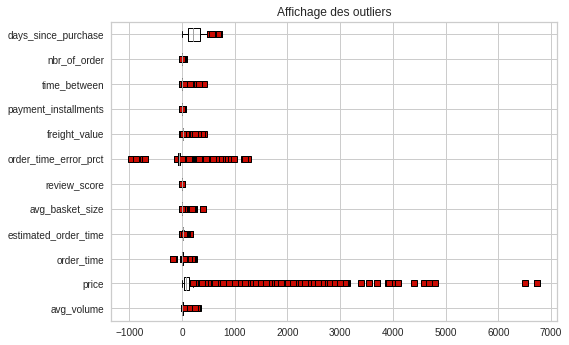

In [ ]:
#for col in echantillon_traitement_outlier:
plt.title('Affichage des outliers')
red_square = dict(markerfacecolor='r', marker='s')
echantillon_traitement_outlier.boxplot(figsize=(20,15),flierprops=red_square, vert=False, whis=0.75)  
plt.show()   

In [ ]:
import plotly.express as px
import plotly.graph_objects as go
df = echantillon_traitement_outlier
xval = df.values
names = df.index
features = df.columns
fig = go.Figure()

for xd, yd in zip( features,xval):
        fig.add_trace(go.Box(
            y=yd,
            name=xd,
            boxpoints='all',
            line_width=1)
        )
fig.show()

#### Methode 1 : Traitement des outliers par isolation forest 

In [ ]:
# dictionnaire de catégorie 
dict_categories = {
    # home_garden_garage
    'bed_bath_table': 'home_garden_garage',
    'kitchen_dining_laundry_garden_furniture': 'home_garden_garage',
    'la_cuisine': 'home_garden_garage',
    'home_confort': 'home_garden_garage',
    'home_comfort_2': 'home_garden_garage',
    'portable_kitchen_and_food_preparers': 'home_garden_garage',
    'air_conditioning': 'home_garden_garage',
    'small_appliances': 'home_garden_garage',
    'small_appliances_home_oven_and_coffee': 'home_garden_garage',
    'home_appliances_2': 'home_garden_garage',
    'home_appliances': 'home_garden_garage',
    'housewares': 'home_garden_garage',
    'arts_and_craftmanship': 'home_garden_garage',
    'christmas_supplies': 'home_garden_garage',
    'furniture_decor': 'home_garden_garage',
    'art': 'home_garden_garage',
    'flowers' : 'home_garden_garage',
    'home_construction': 'home_garden_garage',
    'office_furniture': 'home_garden_garage',
    'furniture_living_room': 'home_garden_garage',
    'furniture_mattress_and_upholstery': 'home_garden_garage',
    'furniture_bedroom': 'home_garden_garage',
    'furnitures': 'home_garden_garage',   
    'construction_tools_construction': 'home_garden_garage',
    'costruction_tools_garden': 'home_garden_garage',
    'costruction_tools_tools': 'home_garden_garage',
    'construction_tools_safety': 'home_garden_garage',
    'construction_tools_lights': 'home_garden_garage',
    'signaling_and_security': 'home_garden_garage',
    'security_and_services': 'home_garden_garage',
    'auto': 'home_garden_garage',
    'garden_tools': 'home_garden_garage',
    

    # multimedia_leisure
    'telephony' : 'multimedia_leisure',
    'electronics': 'multimedia_leisure',
    'computers_accessories': 'multimedia_leisure',
    'consoles_games': 'multimedia_leisure',
    'fixed_telephony': 'multimedia_leisure',
    'audio': 'multimedia_leisure',
    'computers': 'multimedia_leisure',
    'tablets_printing_image': 'multimedia_leisure',
    'pc_gamer': 'multimedia_leisure',
    'sports_leisure' : 'multimedia_leisure',
    'musical_instruments': 'multimedia_leisure',
    'party_supplies': 'multimedia_leisure',
    'luggage_accessories': 'multimedia_leisure',
    'books' : 'multimedia_leisure',
    'books_imported': 'multimedia_leisure',
    'books_general_interest': 'multimedia_leisure',
    'books_technical': 'multimedia_leisure',
    'toys': 'multimedia_leisure',
    'cine_photo': 'multimedia_leisure',
    'cds_dvds_musicals': 'multimedia_leisure',
    'music': 'multimedia_leisure',
    'dvds_blu_ray': 'multimedia_leisure',
    'food_drink' : 'multimedia_leisure',
    'food' : 'multimedia_leisure',
    'drinks' : 'multimedia_leisure',
    'stationery' : 'multimedia_leisure',
  
    # fashion_health_beauty
    'watches_gifts' : 'fashion_health_beauty',
    'fashion_bags_accessories' : 'fashion_health_beauty',
    'fashion_underwear_beach' : 'fashion_health_beauty',
    'fashion_shoes' : 'fashion_health_beauty', 
    'fashion_male_clothing' : 'fashion_health_beauty',
    'fashio_female_clothing' : 'fashion_health_beauty',
    'fashion_sport' : 'fashion_health_beauty',
    'fashion_childrens_clothes' : 'fashion_health_beauty',
    'health_beauty' : 'fashion_health_beauty', 
    'diapers_and_hygiene' : 'fashion_health_beauty',
    'perfumery' : 'fashion_health_beauty',

    # other
    'baby': 'other',
    'Unknown' : 'other',
    'market_place' : 'other', 
    'cool_stuff' : 'other',
    'pet_shop' : 'other',
    'industry_commerce_and_business' : 'other',
    'agro_industry_and_commerce' : 'other'}

table_segmentation['favourite_categ'] = table_segmentation['product_category_name_english'].replace(
    dict_categories)


In [ ]:
table_segmentation.drop('product_category_name_english', axis=1, inplace=True)

In [ ]:
# I create spend column
table_segmentation['spend'] = table_segmentation['price'] * table_segmentation['nbr_of_order'] + \
              table_segmentation['freight_value']
# I create freight_value_prct
table_segmentation['freight_value_prct'] = table_segmentation['freight_value'] * 100 / table_segmentation['spend']

table_segmentation.drop('freight_value', axis=1, inplace=True)

In [ ]:
table_segmentation.head()

,Unnamed: 0,customer_unique_id,avg_volume,customer_city,customer_state,nbr_of_order,price,order_time,estimated_order_time,avg_basket_size,order_purchase_timestamp,fist_purchase_date,review_score,geolocation_lat,geolocation_lng,order_time_error_prct,freight_value,favourite_seller,payment_type,payment_installments
0,0,0000366f3b9a7992bf8c76cfdf3221e2,7.616,cajamar,SP,1,129.90,6.0,10.0,1.0,2018-05-10 10:56:27,2018-05-10 10:56:27,5.0,-23.335331,-46.828647,-40.000000,12.00,da8622b14eb17ae2831f4ac5b9dab84a,credit_card,8.0
1,1,0000b849f77a49e4a4ce2b2a4ca5be3f,5.148,osasco,SP,1,18.90,3.0,7.0,1.0,2018-05-07 11:11:27,2018-05-07 11:11:27,4.0,-23.567395,-46.792957,-57.142857,8.29,138dbe45fc62f1e244378131a6801526,credit_card,1.0
2,2,0000f46a3911fa3c0805444483337064,43.750,sao jose,SC,1,69.00,25.0,27.0,1.0,2017-03-10 21:05:03,2017-03-10 21:05:03,3.0,-27.543787,-48.625680,-7.407407,17.22,3d871de0142ce09b7081e2b9d1733cb1,credit_card,8.0
3,3,0000f6ccb0745a6a4b88665a16c9f078,1.045,belem,PA,1,25.99,20.0,31.0,1.0,2017-10-12 20:29:41,2017-10-12 20:29:41,4.0,-1.311011,-48.482884,-35.483871,17.63,ef506c96320abeedfb894c34db06f478,credit_card,4.0
4,4,0004aac84e0df4da2b147fca70cf8255,0.528,sorocaba,SP,1,180.00,13.0,20.0,1.0,2017-11-14 19:45:42,2017-11-14 19:45:42,5.0,-23.504368,-47.466156,-35.000000,16.89,70a12e78e608ac31179aea7f8422044b,credit_card,6.0


In [ ]:
import datetime as dt

In [ ]:
#table_segmentation = table_segmentation.drop('customer_city',axis=1)

In [ ]:
table_segmentation = table_segmentation.drop('Unnamed: 0',axis=1)

In [ ]:
df_iso = table_segmentation.drop('customer_unique_id', axis=1)

df_iso['favourite_categ'] = df_iso['favourite_categ'].astype(
    'category').cat.codes

df_iso['order_purchase_timestamp'] = df_iso['order_purchase_timestamp'].map(dt.datetime.toordinal)


df_iso['fist_purchase_date'] = df_iso['fist_purchase_date'].map(dt.datetime.toordinal)


df_iso['payment_type'] = df_iso['payment_type'].astype('category').cat.codes

df_iso['customer_city'] = df_iso['customer_city'].astype('category').cat.codes

df_iso['customer_state'] = df_iso['customer_state'].astype('category').cat.codes


In [ ]:
df_iso

,avg_volume,customer_city,customer_state,nbr_of_order,price,order_time,estimated_order_time,avg_basket_size,order_purchase_timestamp,fist_purchase_date,review_score,geolocation_lat,geolocation_lng,order_time_error_prct,payment_type,payment_installments,favourite_categ,spend,freight_value_prct
0,7.616,550,22,1,129.90,6.0,10.0,1.0,736824,736824,5.0,-23.335331,-46.828647,-40.000000,1,8.0,1,141.90,8.456660
1,5.148,2255,22,1,18.90,3.0,7.0,1.0,736821,736821,4.0,-23.567395,-46.792957,-57.142857,1,1.0,0,27.19,30.489150
2,1.045,366,11,1,25.99,20.0,31.0,1.0,736614,736614,4.0,-1.311011,-48.482884,-35.483871,1,4.0,2,43.62,40.417240
3,0.528,3310,22,1,180.00,13.0,20.0,1.0,736647,736647,5.0,-23.504368,-47.466156,-35.000000,1,6.0,2,196.89,8.578394
4,8.241,3164,22,1,154.00,1.0,13.0,1.0,736789,736789,4.0,-23.511323,-46.693146,-92.307692,1,8.0,1,166.98,7.773386
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82471,28.600,418,16,1,64.99,10.0,17.0,1.0,736632,736632,5.0,-22.151826,-42.418110,-41.176471,0,1.0,3,81.20,19.963054
82472,1.638,3554,19,1,58.00,8.0,31.0,1.0,736680,736680,5.0,-28.931645,-51.545395,-74.193548,0,1.0,0,73.16,20.721706
82473,32.076,1142,2,1,64.89,30.0,32.0,1.0,736673,736673,4.0,-12.221792,-38.962517,-6.250000,1,1.0,3,84.58,23.279735
82474,4.480,428,5,1,115.00,11.0,25.0,1.0,736816,736816,5.0,-21.125061,-41.666268,-56.000000,1,5.0,0,133.69,13.980103


In [ ]:
df_iso = df_iso.fillna(df_iso.median())

In [ ]:

clf = IsolationForest(random_state=0,
                      contamination=0.15).fit(df_iso)

table_segmentation['outliers'] = pd.Series(clf.predict(df_iso), index=df_iso.index)

In [ ]:
table_segmentation

,customer_unique_id,avg_volume,customer_city,customer_state,nbr_of_order,price,order_time,estimated_order_time,avg_basket_size,order_purchase_timestamp,fist_purchase_date,review_score,geolocation_lat,geolocation_lng,order_time_error_prct,payment_type,payment_installments,favourite_categ,spend,freight_value_prct,outliers
0,0000366f3b9a7992bf8c76cfdf3221e2,7.616,cajamar,SP,1,129.90,6.0,10.0,1.0,2018-05-10 10:56:27,2018-05-10 10:56:27,5.0,-23.335331,-46.828647,-40.000000,credit_card,8.0,home_garden_garage,141.90,8.456660,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,5.148,osasco,SP,1,18.90,3.0,7.0,1.0,2018-05-07 11:11:27,2018-05-07 11:11:27,4.0,-23.567395,-46.792957,-57.142857,credit_card,1.0,fashion_health_beauty,27.19,30.489150,1
2,0000f6ccb0745a6a4b88665a16c9f078,1.045,belem,PA,1,25.99,20.0,31.0,1.0,2017-10-12 20:29:41,2017-10-12 20:29:41,4.0,-1.311011,-48.482884,-35.483871,credit_card,4.0,multimedia_leisure,43.62,40.417240,1
3,0004aac84e0df4da2b147fca70cf8255,0.528,sorocaba,SP,1,180.00,13.0,20.0,1.0,2017-11-14 19:45:42,2017-11-14 19:45:42,5.0,-23.504368,-47.466156,-35.000000,credit_card,6.0,multimedia_leisure,196.89,8.578394,1
4,0004bd2a26a76fe21f786e4fbd80607f,8.241,sao paulo,SP,1,154.00,1.0,13.0,1.0,2018-04-05 19:33:16,2018-04-05 19:33:16,4.0,-23.511323,-46.693146,-92.307692,credit_card,8.0,home_garden_garage,166.98,7.773386,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82471,fffa431dd3fcdefea4b1777d114144f2,28.600,bom jardim,RJ,1,64.99,10.0,17.0,1.0,2017-10-30 20:39:50,2017-10-30 20:39:50,5.0,-22.151826,-42.418110,-41.176471,boleto,1.0,other,81.20,19.963054,1
82472,fffb09418989a0dbff854a28163e47c6,1.638,veranopolis,RS,1,58.00,8.0,31.0,1.0,2017-12-17 19:14:35,2017-12-17 19:14:35,5.0,-28.931645,-51.545395,-74.193548,boleto,1.0,fashion_health_beauty,73.16,20.721706,1
82473,fffea47cd6d3cc0a88bd621562a9d061,32.076,feira de santana,BA,1,64.89,30.0,32.0,1.0,2017-12-10 20:07:56,2017-12-10 20:07:56,4.0,-12.221792,-38.962517,-6.250000,credit_card,1.0,other,84.58,23.279735,-1
82474,ffff5962728ec6157033ef9805bacc48,4.480,bom jesus do norte,ES,1,115.00,11.0,25.0,1.0,2018-05-02 15:17:41,2018-05-02 15:17:41,5.0,-21.125061,-41.666268,-56.000000,credit_card,5.0,fashion_health_beauty,133.69,13.980103,1


In [ ]:
print('Par isolation forest je supprime', len(table_segmentation.loc[table_segmentation['outliers'] == -1]), 'outliers')
table_segmentation = table_segmentation.drop(table_segmentation.loc[table_segmentation['outliers'] == -1].index)
table_segmentation = table_segmentation.drop('outliers', axis=1)

Par isolation forest je supprime 12372 outliers


In [ ]:
table_segmentation.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_outlier_ok.csv')

In [ ]:
table_segmentation = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_outlier_ok.csv',parse_dates=['order_purchase_timestamp','fist_purchase_date'],dayfirst=True)

In [ ]:
table_segmentation.time_between.sum()

18324.0

In [ ]:
df_iso

,avg_volume,customer_city,customer_state,nbr_of_order,price,order_time,estimated_order_time,avg_basket_size,fist_purchase_date,review_score,geolocation_lat,geolocation_lng,order_time_error_prct,favourite_seller,payment_type,payment_installments,days_since_purchase,time_between,favourite_categ,spend,freight_value_prct
0,7.616,647,25,1,129.90,6.0,10.0,1.0,2018-05-10 10:56:27,5.0,-23.335331,-46.828647,-40.000000,da8622b14eb17ae2831f4ac5b9dab84a,1,8.0,111,0.0,1,141.90,8.456660
1,5.148,2565,25,1,18.90,3.0,7.0,1.0,2018-05-07 11:11:27,4.0,-23.567395,-46.792957,-57.142857,138dbe45fc62f1e244378131a6801526,1,1.0,114,0.0,0,27.19,30.489150
2,43.750,3478,23,1,69.00,25.0,27.0,1.0,2017-03-10 21:05:03,3.0,-27.543787,-48.625680,-7.407407,3d871de0142ce09b7081e2b9d1733cb1,1,8.0,536,0.0,2,86.22,19.972164
3,1.045,443,13,1,25.99,20.0,31.0,1.0,2017-10-12 20:29:41,4.0,-1.311011,-48.482884,-35.483871,ef506c96320abeedfb894c34db06f478,1,4.0,320,0.0,2,43.62,40.417240
4,0.528,3715,25,1,180.00,13.0,20.0,1.0,2017-11-14 19:45:42,5.0,-23.504368,-47.466156,-35.000000,70a12e78e608ac31179aea7f8422044b,1,6.0,287,0.0,2,196.89,8.578394
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97027,251.625,3218,15,2,785.00,27.0,54.0,2.0,2017-06-08 21:00:36,5.0,-8.363166,-36.559088,-50.000000,17f51e7198701186712e53a39c564617,1,10.0,446,0.0,0,1818.71,13.675077
97028,32.076,1311,4,1,64.89,30.0,32.0,1.0,2017-12-10 20:07:56,4.0,-12.221792,-38.962517,-6.250000,7aa4334be125fcdd2ba64b3180029f14,1,1.0,261,0.0,3,84.58,23.279735
97029,3.315,3697,12,1,89.90,14.0,44.0,1.0,2017-02-07 15:49:16,5.0,-11.829317,-55.496443,-68.181818,54aa8463e87776b5612f4bdc4bd5d4de,1,1.0,567,0.0,1,112.46,20.060466
97030,4.480,511,7,1,115.00,11.0,25.0,1.0,2018-05-02 15:17:41,5.0,-21.125061,-41.666268,-56.000000,7d13fca15225358621be4086e1eb0964,1,5.0,118,0.0,0,133.69,13.980103


In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving functions.py to functions.py
User uploaded file "functions.py" with length 11407 bytes


In [ ]:
## insertions des fonctions math pca et visualisation

from functions import *

#### Methode 2 : Traitement des valeurs abérrantes manuellement

In [ ]:
#traitement des valeurs abérrantes
valeur_aberrante_longeur = table_segmentation[table_segmentation['product_length_cm'] >30]
valeur_aberrante_longeur.product_length_cm.count()

41017

In [ ]:
table_segmentation.drop(valeur_aberrante_longeur.index,axis=0)

,customer_unique_id,order_id,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,shipping_limit_date,price,payment_value,payment_sequential,payment_type,payment_installments,freight_value,order_status,review_score,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_zip_code_prefix,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
1,af0f26435fade1ca984d9affda307199,bc8a5de6abf5b14f98a6135a7fb46731,sports_leisure,44.0,1089.0,1.0,300.0,16.0,5.0,15.0,campinas,SP,2017-09-05 12:50:19,10.80,158.80,1.0,credit_card,4.0,2.42,delivered,3.0,2017-08-30 11:47:52,2017-08-30 12:50:19,2017-08-30 19:22:18,2017-09-01 16:51:26,2017-09-20 00:00:00,9310.0,maua,SP,9310.0,-23.675178,-46.449833
10,9a70db677c8e4e9e25e36729362fe756,0504447548229e075dea8441b37b1e2a,stationery,30.0,832.0,5.0,2000.0,25.0,55.0,40.0,mogi guacu,SP,2017-10-06 02:14:42,199.90,221.79,1.0,boleto,1.0,21.89,delivered,5.0,2017-09-28 19:31:57,2017-09-30 02:14:42,2017-10-02 19:33:19,2017-10-06 17:03:59,2017-11-03 00:00:00,97700.0,santiago,RS,97700.0,-29.189989,-54.871998
19,9cb05885262e3459811af52c1818e354,68350de28c940e619bfce38aa0001ef2,luggage_accessories,33.0,280.0,4.0,900.0,23.0,22.0,35.0,mogi guacu,SP,2017-11-08 20:10:29,59.99,68.10,1.0,credit_card,3.0,8.11,delivered,4.0,2017-11-02 19:52:30,2017-11-02 20:10:29,2017-11-03 20:12:54,2017-11-06 18:21:18,2017-11-16 00:00:00,4617.0,sao paulo,SP,4617.0,-23.627568,-46.663081
27,1403b49485b8aa0a7880c320ad233fda,de76f809479b8391b6166b1448d83f3f,stationery,24.0,342.0,1.0,1300.0,20.0,49.0,33.0,mogi guacu,SP,2017-07-10 16:10:07,189.99,202.82,1.0,credit_card,10.0,12.83,delivered,3.0,2017-07-03 15:56:09,2017-07-03 16:10:07,2017-07-04 13:57:32,2017-07-06 18:33:06,2017-07-24 00:00:00,2033.0,sao paulo,SP,2033.0,-23.502154,-46.616881
31,93bb9244111f8a098b0727e70f0b8b35,76f365ea86277e79c94d5fd3dbc1db80,fashion_bags_accessories,46.0,424.0,2.0,3300.0,30.0,60.0,40.0,mogi guacu,SP,2017-04-05 02:10:34,289.90,317.16,1.0,boleto,1.0,27.26,delivered,5.0,2017-03-28 09:00:00,2017-03-29 02:10:34,2017-03-29 11:18:22,2017-03-31 13:12:53,2017-04-26 00:00:00,3470.0,sao paulo,SP,3470.0,-23.572821,-46.523296
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116641,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,food_drink,54.0,1342.0,1.0,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.00,82.46,1.0,credit_card,1.0,11.23,delivered,5.0,2018-07-30 18:33:10,2018-07-30 19:40:14,2018-07-31 14:39:00,2018-08-01 19:04:34,2018-08-06 00:00:00,4685.0,sao paulo,SP,4685.0,-23.673153,-46.686683
116642,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,food_drink,54.0,1342.0,1.0,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.00,82.46,1.0,credit_card,1.0,11.23,delivered,5.0,2018-07-30 18:33:10,2018-07-30 19:40:14,2018-07-31 14:39:00,2018-08-01 19:04:34,2018-08-06 00:00:00,4685.0,sao paulo,SP,4685.0,-23.673153,-46.686683
116643,22534f67ddbf35d6831b4b0d4beea813,4dee2a3e6470bab984859192120d6e3e,sports_leisure,41.0,754.0,1.0,3180.0,28.0,22.0,26.0,sao paulo,SP,2018-05-09 13:11:56,75.90,98.97,1.0,credit_card,2.0,23.07,delivered,5.0,2018-05-03 12:53:41,2018-05-03 13:11:56,2018-05-03 13:15:00,2018-05-08 17:32:47,2018-05-23 00:00:00,81650.0,curitiba,PR,81650.0,-25.496876,-49.232400
116644,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,pelotas,RS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#traitement des valeurs abérrantes
valeur_aberrante_hauteur = table_segmentation[table_segmentation['product_height_cm'] >60]
valeur_aberrante_hauteur.product_length_cm.count()

2137

In [ ]:
table_segmentation.drop(valeur_aberrante_hauteur.index,axis=0)

,customer_unique_id,order_id,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,shipping_limit_date,price,payment_value,payment_sequential,payment_type,payment_installments,freight_value,order_status,review_score,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_zip_code_prefix,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
0,f421a2a66b69dbfe6db0c87845281a90,4a90af3e85dd563884e2afeab1091394,sports_leisure,26.0,417.0,3.0,700.0,43.0,15.0,35.0,campinas,SP,2017-08-25 20:50:19,106.2,115.76,1.0,credit_card,2.0,9.56,delivered,5.0,2017-08-21 20:35:44,2017-08-21 20:50:19,2017-08-29 20:33:29,2017-08-30 16:07:13,2017-09-01 00:00:00,4661.0,sao paulo,SP,4661.0,-23.667671,-46.677754
1,af0f26435fade1ca984d9affda307199,bc8a5de6abf5b14f98a6135a7fb46731,sports_leisure,44.0,1089.0,1.0,300.0,16.0,5.0,15.0,campinas,SP,2017-09-05 12:50:19,10.8,158.80,1.0,credit_card,4.0,2.42,delivered,3.0,2017-08-30 11:47:52,2017-08-30 12:50:19,2017-08-30 19:22:18,2017-09-01 16:51:26,2017-09-20 00:00:00,9310.0,maua,SP,9310.0,-23.675178,-46.449833
2,b4527423469300ee354458e1b5f961be,6d953888a914b67350d5bc4d48f2acab,sports_leisure,27.0,485.0,2.0,600.0,35.0,15.0,28.0,campinas,SP,2017-05-11 16:25:11,101.7,117.62,1.0,credit_card,2.0,15.92,delivered,1.0,2017-05-05 16:12:29,2017-05-05 16:25:11,2017-05-12 05:43:55,2017-06-02 16:57:44,2017-05-30 00:00:00,32223.0,contagem,MG,32223.0,-19.961706,-44.035239
5,021dbb48a965542d846e18a6799d37c0,42f364e1317053c36378cc534b19ab6e,luggage_accessories,23.0,836.0,7.0,1400.0,55.0,40.0,25.0,mogi guacu,SP,2017-07-06 00:23:32,139.9,158.13,1.0,credit_card,10.0,18.23,delivered,4.0,2017-06-29 00:10:22,2017-06-29 00:23:32,2017-06-29 10:27:32,2017-07-12 15:36:50,2017-07-24 00:00:00,37750.0,machado,MG,37750.0,-21.680839,-45.923258
8,ff2cfbe44d7249b98eed0e860fe3e53c,d82845f8b7ebd4d9b7ebae995e0ff08b,luggage_accessories,24.0,520.0,3.0,4900.0,38.0,55.0,22.0,mogi guacu,SP,2017-05-30 23:42:44,229.9,486.02,1.0,credit_card,10.0,13.11,delivered,5.0,2017-05-23 23:25:37,2017-05-23 23:42:44,2017-05-24 09:50:24,2017-05-28 02:48:50,2017-06-14 00:00:00,2310.0,sao paulo,SP,2310.0,-23.471944,-46.598645
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116641,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,food_drink,54.0,1342.0,1.0,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.0,82.46,1.0,credit_card,1.0,11.23,delivered,5.0,2018-07-30 18:33:10,2018-07-30 19:40:14,2018-07-31 14:39:00,2018-08-01 19:04:34,2018-08-06 00:00:00,4685.0,sao paulo,SP,4685.0,-23.673153,-46.686683
116642,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,food_drink,54.0,1342.0,1.0,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.0,82.46,1.0,credit_card,1.0,11.23,delivered,5.0,2018-07-30 18:33:10,2018-07-30 19:40:14,2018-07-31 14:39:00,2018-08-01 19:04:34,2018-08-06 00:00:00,4685.0,sao paulo,SP,4685.0,-23.673153,-46.686683
116643,22534f67ddbf35d6831b4b0d4beea813,4dee2a3e6470bab984859192120d6e3e,sports_leisure,41.0,754.0,1.0,3180.0,28.0,22.0,26.0,sao paulo,SP,2018-05-09 13:11:56,75.9,98.97,1.0,credit_card,2.0,23.07,delivered,5.0,2018-05-03 12:53:41,2018-05-03 13:11:56,2018-05-03 13:15:00,2018-05-08 17:32:47,2018-05-23 00:00:00,81650.0,curitiba,PR,81650.0,-25.496876,-49.232400
116644,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,pelotas,RS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#traitement des valeurs abérrantes
valeur_aberrante_largeur = table_segmentation[table_segmentation['product_width_cm'] >60]
valeur_aberrante_largeur.product_length_cm.count()

1367

In [ ]:
table_segmentation.drop(valeur_aberrante_largeur.index,axis=0)

,customer_unique_id,order_id,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,shipping_limit_date,price,payment_value,payment_sequential,payment_type,payment_installments,freight_value,order_status,review_score,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_zip_code_prefix,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
0,f421a2a66b69dbfe6db0c87845281a90,4a90af3e85dd563884e2afeab1091394,sports_leisure,26.0,417.0,3.0,700.0,43.0,15.0,35.0,campinas,SP,2017-08-25 20:50:19,106.2,115.76,1.0,credit_card,2.0,9.56,delivered,5.0,2017-08-21 20:35:44,2017-08-21 20:50:19,2017-08-29 20:33:29,2017-08-30 16:07:13,2017-09-01 00:00:00,4661.0,sao paulo,SP,4661.0,-23.667671,-46.677754
1,af0f26435fade1ca984d9affda307199,bc8a5de6abf5b14f98a6135a7fb46731,sports_leisure,44.0,1089.0,1.0,300.0,16.0,5.0,15.0,campinas,SP,2017-09-05 12:50:19,10.8,158.80,1.0,credit_card,4.0,2.42,delivered,3.0,2017-08-30 11:47:52,2017-08-30 12:50:19,2017-08-30 19:22:18,2017-09-01 16:51:26,2017-09-20 00:00:00,9310.0,maua,SP,9310.0,-23.675178,-46.449833
2,b4527423469300ee354458e1b5f961be,6d953888a914b67350d5bc4d48f2acab,sports_leisure,27.0,485.0,2.0,600.0,35.0,15.0,28.0,campinas,SP,2017-05-11 16:25:11,101.7,117.62,1.0,credit_card,2.0,15.92,delivered,1.0,2017-05-05 16:12:29,2017-05-05 16:25:11,2017-05-12 05:43:55,2017-06-02 16:57:44,2017-05-30 00:00:00,32223.0,contagem,MG,32223.0,-19.961706,-44.035239
3,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,luggage_accessories,24.0,513.0,5.0,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.9,128.44,2.0,voucher,1.0,96.70,delivered,5.0,2017-06-07 09:31:57,2017-06-07 09:42:40,2017-06-08 09:14:50,2017-07-03 16:34:33,2017-07-13 00:00:00,76807.0,porto velho,RO,76807.0,-8.791929,-63.893810
4,f65b5286313fd2f342da4772f30edf75,c9b01bef18eb84888f0fd071b8413b38,luggage_accessories,24.0,513.0,5.0,9800.0,42.0,70.0,25.0,mogi guacu,SP,2017-06-14 09:42:40,269.9,238.16,1.0,credit_card,6.0,96.70,delivered,5.0,2017-06-07 09:31:57,2017-06-07 09:42:40,2017-06-08 09:14:50,2017-07-03 16:34:33,2017-07-13 00:00:00,76807.0,porto velho,RO,76807.0,-8.791929,-63.893810
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116641,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,food_drink,54.0,1342.0,1.0,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.0,82.46,1.0,credit_card,1.0,11.23,delivered,5.0,2018-07-30 18:33:10,2018-07-30 19:40:14,2018-07-31 14:39:00,2018-08-01 19:04:34,2018-08-06 00:00:00,4685.0,sao paulo,SP,4685.0,-23.673153,-46.686683
116642,eee8e69f50656b535d8ff7c66c8d99d6,e6c4a6f6dd627304bc8f832080958a32,food_drink,54.0,1342.0,1.0,1575.0,20.0,18.0,18.0,sao paulo,SP,2018-08-03 19:31:52,30.0,82.46,1.0,credit_card,1.0,11.23,delivered,5.0,2018-07-30 18:33:10,2018-07-30 19:40:14,2018-07-31 14:39:00,2018-08-01 19:04:34,2018-08-06 00:00:00,4685.0,sao paulo,SP,4685.0,-23.673153,-46.686683
116643,22534f67ddbf35d6831b4b0d4beea813,4dee2a3e6470bab984859192120d6e3e,sports_leisure,41.0,754.0,1.0,3180.0,28.0,22.0,26.0,sao paulo,SP,2018-05-09 13:11:56,75.9,98.97,1.0,credit_card,2.0,23.07,delivered,5.0,2018-05-03 12:53:41,2018-05-03 13:11:56,2018-05-03 13:15:00,2018-05-08 17:32:47,2018-05-23 00:00:00,81650.0,curitiba,PR,81650.0,-25.496876,-49.232400
116644,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,pelotas,RS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#traitement des valeurs abérrantes poids
valeur_aberrante_poids = table_segmentation[table_segmentation['product_weight_g'] >7500]
valeur_aberrante_poids.product_weight_g.count()

9015

In [ ]:
table_segmentation.drop(valeur_aberrante_poids.index,axis=0,inplace=True)

In [ ]:
#traitement des valeurs abérrantes
valeur_aberrante_nom = table_segmentation[table_segmentation['product_description_lenght'] > 1400]
valeur_aberrante_nom.product_description_lenght.count()

13942

In [ ]:
table_segmentation.describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,price,payment_value,payment_sequential,payment_installments,freight_value,review_score,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
count,107569.000000,107569.000000,107569.000000,107568.000000,107568.000000,107568.000000,107568.000000,107569.000000,107566.000000,107566.000000,107566.000000,107569.000000,107569.000000,107566.000000,107231.000000,107231.000000,107231.000000
mean,48.819520,778.791074,2.196841,1202.341403,28.665523,14.754295,21.835834,107.364623,154.488894,1.088420,2.838257,17.841758,4.030167,35075.319051,34987.868368,-21.232531,-46.186874
std,10.011042,654.901651,1.706420,1507.522684,14.769333,10.557448,10.394352,155.998454,240.186981,0.679617,2.675284,9.905099,1.390999,29865.914420,29852.238490,5.593916,4.064092
min,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000,0.850000,0.000000,1.000000,0.000000,0.000000,1.000000,1003.000000,1003.000000,-36.605374,-72.666706
25%,42.000000,341.000000,1.000000,250.000000,18.000000,8.000000,15.000000,38.900000,57.990000,1.000000,1.000000,12.790000,4.000000,11075.000000,11070.000000,-23.590808,-48.085951
50%,52.000000,592.000000,1.000000,600.000000,23.000000,12.000000,19.000000,69.900000,101.650000,1.000000,1.000000,15.980000,5.000000,24330.000000,24240.000000,-22.931256,-46.631962
75%,57.000000,960.000000,3.000000,1500.000000,35.000000,20.000000,28.000000,120.000000,173.857500,1.000000,4.000000,19.590000,5.000000,58967.500000,58401.000000,-20.193636,-43.625993
max,76.000000,3992.000000,18.000000,7500.000000,105.000000,105.000000,118.000000,6729.000000,13664.080000,26.000000,24.000000,251.500000,5.000000,99980.000000,99980.000000,45.065933,9.341528


### Les relations entre variables



##### Etude PCA
____

Nous allons effectuer une ACP ( analyse en composante principale ) concernant l'analyse de chaques consommateurs lors de leur experience d'achat. 
Ainsi notre jeu d'analyse constitué incluera les differentes variables concernant le produit ( nombre de photos , taile, poids, longeur , largeur ) , la transaction ( montant d'achat, valeur de la transation, montant de paiement payé ) 

Voici les différentes etapes pour notre analyse :
  - Selection des données
  - Centrer nos données ( standardisation )
  - pourcentage de variance expliqué 
  - Contribution de chaque variable au composantes principales
  


##### Selection des données

In [ ]:
# Chargement des données
pca_data = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_outlier_ok.csv')

In [ ]:

pca_data.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
pca_data.columns

Index(['Unnamed: 0', 'customer_unique_id', 'avg_volume', 'customer_city',
       'customer_state', 'nbr_of_order', 'price', 'order_time',
       'estimated_order_time', 'avg_basket_size', 'review_score',
       'geolocation_lat', 'geolocation_lng', 'order_time_error_prct',
       'payment_type', 'payment_installments', 'days_since_purchase',
       'time_between', 'favourite_categ', 'spend', 'freight_value_prct'],
      dtype='object')

In [ ]:
pca_data

,Unnamed: 0,customer_unique_id,avg_volume,customer_city,customer_state,nbr_of_order,price,order_time,estimated_order_time,avg_basket_size,review_score,geolocation_lat,geolocation_lng,order_time_error_prct,payment_type,payment_installments,days_since_purchase,time_between,favourite_categ,spend,freight_value_prct
0,0,0000366f3b9a7992bf8c76cfdf3221e2,7.616,cajamar,SP,1,129.90,6.0,10.0,1.0,5.0,-23.335331,-46.828647,-40.000000,credit_card,8.0,111,0.0,home_garden_garage,141.90,8.456660
1,1,0000b849f77a49e4a4ce2b2a4ca5be3f,5.148,osasco,SP,1,18.90,3.0,7.0,1.0,4.0,-23.567395,-46.792957,-57.142857,credit_card,1.0,114,0.0,fashion_health_beauty,27.19,30.489150
2,2,0000f46a3911fa3c0805444483337064,43.750,sao jose,SC,1,69.00,25.0,27.0,1.0,3.0,-27.543787,-48.625680,-7.407407,credit_card,8.0,536,0.0,multimedia_leisure,86.22,19.972164
3,3,0000f6ccb0745a6a4b88665a16c9f078,1.045,belem,PA,1,25.99,20.0,31.0,1.0,4.0,-1.311011,-48.482884,-35.483871,credit_card,4.0,320,0.0,multimedia_leisure,43.62,40.417240
4,4,0004aac84e0df4da2b147fca70cf8255,0.528,sorocaba,SP,1,180.00,13.0,20.0,1.0,5.0,-23.504368,-47.466156,-35.000000,credit_card,6.0,287,0.0,multimedia_leisure,196.89,8.578394
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82472,97026,fffb09418989a0dbff854a28163e47c6,1.638,veranopolis,RS,1,58.00,8.0,31.0,1.0,5.0,-28.931645,-51.545395,-74.193548,boleto,1.0,254,0.0,fashion_health_beauty,73.16,20.721706
82473,97028,fffea47cd6d3cc0a88bd621562a9d061,32.076,feira de santana,BA,1,64.89,30.0,32.0,1.0,4.0,-12.221792,-38.962517,-6.250000,credit_card,1.0,261,0.0,other,84.58,23.279735
82474,97029,ffff371b4d645b6ecea244b27531430a,3.315,sinop,MT,1,89.90,14.0,44.0,1.0,5.0,-11.829317,-55.496443,-68.181818,credit_card,1.0,567,0.0,home_garden_garage,112.46,20.060466
82475,97030,ffff5962728ec6157033ef9805bacc48,4.480,bom jesus do norte,ES,1,115.00,11.0,25.0,1.0,5.0,-21.125061,-41.666268,-56.000000,credit_card,5.0,118,0.0,fashion_health_beauty,133.69,13.980103


In [ ]:
# Selection 
mydata = pca_data[['avg_volume',
       'nbr_of_order', 'price', 'order_time', 'estimated_order_time',
       'avg_basket_size', 
       #'order_purchase_timestamp', 'fist_purchase_date',
        #'geolocation_lat', 'geolocation_lng',
       'order_time_error_prct', 
       #'payment_type', 
       'time_between','days_since_purchase',
       'payment_installments',
        'spend', 'freight_value_prct',
       ]]

In [ ]:
#verification du resultat
mydata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70104 entries, 0 to 70103
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   avg_volume             70104 non-null  float64
 1   nbr_of_order           70104 non-null  int64  
 2   price                  70104 non-null  float64
 3   order_time             70104 non-null  float64
 4   estimated_order_time   70104 non-null  float64
 5   avg_basket_size        70104 non-null  float64
 6   order_time_error_prct  70104 non-null  float64
 7   payment_installments   70104 non-null  float64
 8   spend                  70104 non-null  float64
 9   freight_value_prct     70104 non-null  float64
dtypes: float64(9), int64(1)
memory usage: 5.3 MB


In [ ]:
## Traitement des valeur nan par la moyenne de la variables
mydata = mydata.fillna(mydata.mean()) 

In [ ]:
X = mydata.values

##### Standardisation des données

In [ ]:
##### Standardisation des données
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

#### Calcul des composantes principales

In [ ]:
from sklearn import decomposition
from sklearn.decomposition import PCA
import plotly.express as px

In [ ]:

pca = decomposition.PCA()
pca.fit(X_scaled)

PCA(copy=True, iterated_power='auto', n_components=None, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [ ]:
print(pca.explained_variance_ratio_)
print(pca.explained_variance_ratio_.sum())

[0.22396088 0.16538049 0.14430171 0.10592406 0.08361254 0.07588635
 0.07202492 0.06909558 0.03624755 0.01713452 0.00530258 0.00112883]
0.9999999999999998


In [ ]:
exp_var_cumul = np.cumsum(pca.explained_variance_ratio_)

In [ ]:
px.area(
    x=range(1, exp_var_cumul.shape[0] + 1),
    y=exp_var_cumul,
    labels={"x": "# Components", "y": "Explained Variance"}
)

conclusion : 60
 % de variable cumulés avec 4 composantes principales

In [ ]:
pca1 = PCA(n_components=4)

In [ ]:
components = pca1.fit_transform(X_scaled)

In [ ]:
fig = px.scatter(components, x=0, y=1, color=pca_data['review_score'])
fig.show()

array([[-6.60751168e-02, -1.03572387e+00],
       [-1.74294519e+00,  7.63013513e-01],
       [-2.73687887e-01, -4.71691267e-01],
       ...,
       [ 7.84516876e-01, -8.04893338e-01],
       [ 3.66133631e-13,  3.57091297e-13],
       [-8.70203462e-01, -9.24803875e-01]])

In [ ]:
features = mydata.columns


#pca = PCA(n_components=4)
#components = pca.fit_transform(X_scaled)

loadings = pca1.components_.T * np.sqrt(pca1.explained_variance_)

fig = px.scatter(components, x=0, y=1)


for i, feature in enumerate(features):
    fig.add_shape(
        type='line',
        x0=0, y0=0,
        x1=loadings[i, 0],
        y1=loadings[i, 1]
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
    )
fig.show()

Axe F1( 0 ) : 
variable payment installment, avg volume, spend et pric fortement correlé. 
ils ont tout les trois en commun la notion de monnaie.

Axe F2 (1) : 
variable basket size, nb order ( fortement correlé ) 
variable ( estimated-time, order_time ) correlation negative.
on peut dire que les deux variable correlé ont un une caracteristique commune lié à la transaction 








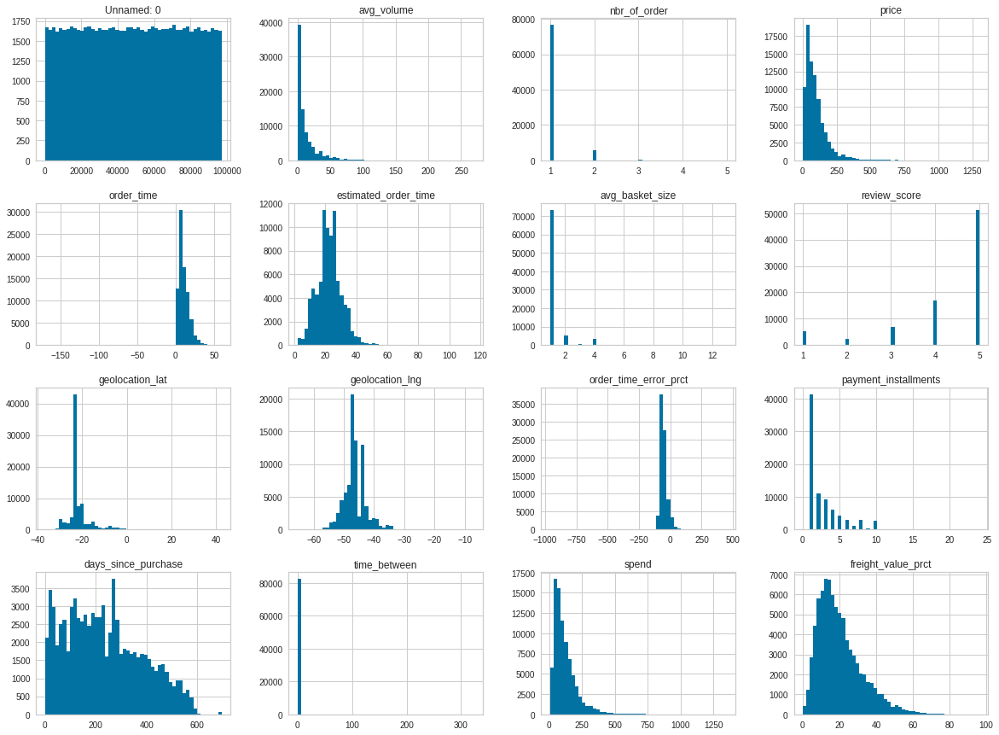

In [ ]:
pca_data.hist(bins=50, figsize=(20,15))
plt.show()

## Partie III Préparer les données

- Copie des données
- Ecrire des fonctions pour toutes les transformation de données
- Nettoyer les données
- Selectionner les variables
- Transformer les variables ( feature ingeniering)
- Recalibrer les variables



##### Copie des données

In [ ]:
pca_data.drop('Unnamed: 0',axis=1,inplace=True)

NameError: ignored

In [ ]:
#pca_data.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_PCA_ok.csv')

In [ ]:
# Chargement des données
prepared_data = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agrege_PCA_ok.csv')

In [ ]:
df= pca_data.copy()

NameError: ignored

In [ ]:
df = prepared_data.copy()

In [ ]:
df.drop('Unnamed: 0',axis=1,inplace=True)

Text(0.5, 1.0, "Matrice de corrélation entre les différent composant d'un consommateur")

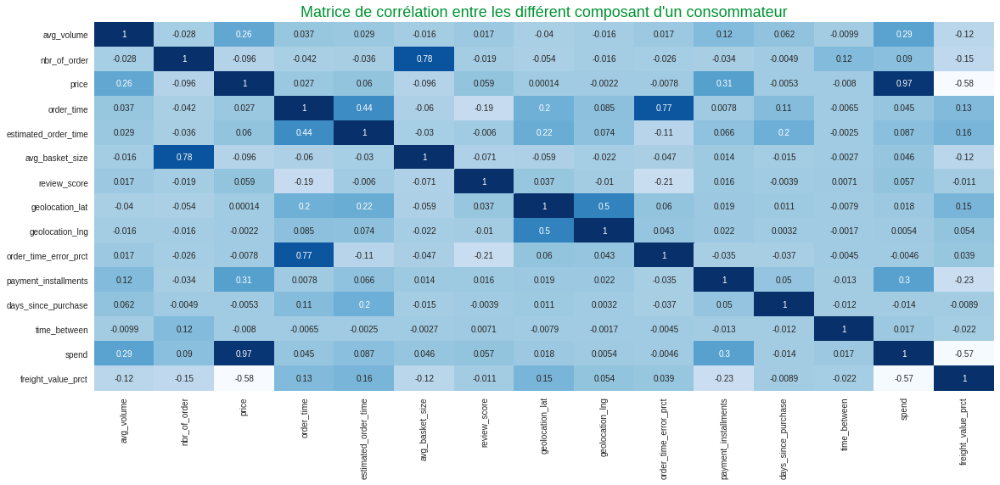

In [ ]:
plt.figure(figsize=(19,8))
sns.heatmap(df.corr(), annot=True, cmap='Blues',cbar=False)
plt.title("Matrice de corrélation entre les différent composant d'un consommateur", fontsize=18, color='#009432')

Conclusion : 
- avg Volume : forte correlation (0,24) avec price et spend (0,27)
- nbr order : forte correlation avec avt basket-size (0,7) 
- price : forte correlation avec ( avg volume ( 0,24, order_time_error (0,77, estimated order time , spend ( 0,98)
- avg basket size : forte correlation avec nb order (0,7) 


##### Ecrire des fonctions pour toutes les transformation de données

#### Transformation de colonne


In [ ]:
def OneHencoder(data_input, data_output):
    donnee = pd.get_dummies(data_input)
    data = pd.merge(data_output,donnee,left_index=True,right_index=True)
    return data

In [ ]:
def preprocess(data):
  encoder = LabelEncoder()
  #Modification des étiquettes
  data = OneHencoder(data.payment_type,data)
  data = OneHencoder(data.order_status,data)
  data = OneHencoder(data.review_score,data)


  return data

In [ ]:
df = preprocess(df)

In [ ]:
df.drop(['order_status','payment_type','review_score'],axis=1,inplace=True)

In [ ]:
#x = preprocess(x)

#### Transformation pour segmentation RMF

afin de différencier les clients, nous pouvons utiliser deux methodes : 
-soit par une segmentatin dite 'comportemental' et en particulier RFM
-soit par les outils de différenciations financiers en particulier la lifetime value 


nous allons utiliser dans notre cas la methode rfm



le principe de la méthode est de calculer un score pour chaque client en fonction des trois critères.


- Recency (R): le délais qui s'est ecoulé depuis la derniere commande 
- Fréquence (F) : Qui a acheté fréquemment. Cela signifie le nombre total d’achats effectué sur une periode (t). ( haute fréquence)
- Valeur monétaire (M) : montant cumué des achats effectués par le client sur la même pèriode

##### Selection de nos variables attendus


In [ ]:
table_segmentation = df.copy()

In [ ]:
list_to_keep = ['price',
                'days_since_purchase',
                'nbr_of_order']

X_total = table_segmentation[list_to_keep]

In [ ]:
X_total

,price,days_since_purchase,nbr_of_order
0,129.90,111,1
1,18.90,114,1
2,69.00,536,1
3,25.99,320,1
4,180.00,287,1
...,...,...,...
82472,58.00,254,1
82473,64.89,261,1
82474,89.90,567,1
82475,115.00,118,1


In [ ]:
X_total = pd.get_dummies(X_total)

In [ ]:
pt = dict()
#Pre-processing
for c in X_total.columns:
    pt[c] = PowerTransformer()
    X_total.loc[:, c] = pt[c].fit_transform(np.array(X_total[c]).reshape(-1, 1))

try:
  X_total = X_total.drop('customer_state_other', axis=1)
except:
  print('column customer_state_other not in X_total')

try:
  X_total = X_total.drop('favourite_categ_other', axis=1)
except:
  print('column favourite_categ_other not in X_total')

column customer_state_other not in X_total
column favourite_categ_other not in X_total


In [ ]:
quantiles = X_total.quantile(q=[0.25,0.5,0.75])

In [ ]:
quantiles = quantiles.to_dict()
quantiles

{'days_since_purchase': {0.25: -0.7163215431547572,
  0.5: 0.044087143634443896,
  0.75: 0.775530722821093},
 'nbr_of_order': {0.25: -0.3613398010932233,
  0.5: -0.3613398010932233,
  0.75: -0.3613398010932233},
 'price': {0.25: -0.6626805228841611,
  0.5: 0.058430915438749814,
  0.75: 0.6651182549493178}}

In [ ]:
def RmfClass(x,p,d):
  if x <= d[p][0.25]:
    return 1
  elif x <= d[p][0.50]:
    return 2
  elif x <= d[p][0.75]:
    return 3
  else:
    return 4

In [ ]:
X_total['R'] = X_total['days_since_purchase'].apply(RmfClass, args=('days_since_purchase',quantiles,))
X_total['F'] = X_total['nbr_of_order'].apply(RmfClass, args=('nbr_of_order',quantiles,))
X_total['M'] = X_total['price'].apply(RmfClass, args=('price',quantiles,))
X_total['RFMClass'] = X_total.R.map(str) \
+ X_total.F.map(str) \
+ X_total.M.map(str)
X_total.head()

,price,days_since_purchase,nbr_of_order,R,F,M,RFMClass
0,0.592843,-0.741936,-0.36134,1,1,3,113
1,-1.613404,-0.716322,-0.36134,1,1,1,111
2,-0.091422,1.647640,-0.36134,4,1,2,412
3,-1.225585,0.628877,-0.36134,3,1,1,311
4,0.929463,0.448396,-0.36134,3,1,4,314


In [ ]:
X_total['RFM_Score'] = X_total[['R','F','M']].sum(axis=1)
print(X_total['RFM_Score'].head())

0    5
1    3
2    7
3    5
4    8
Name: RFM_Score, dtype: int64


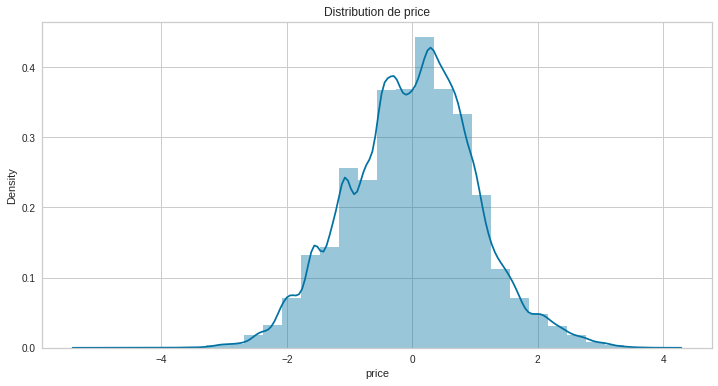

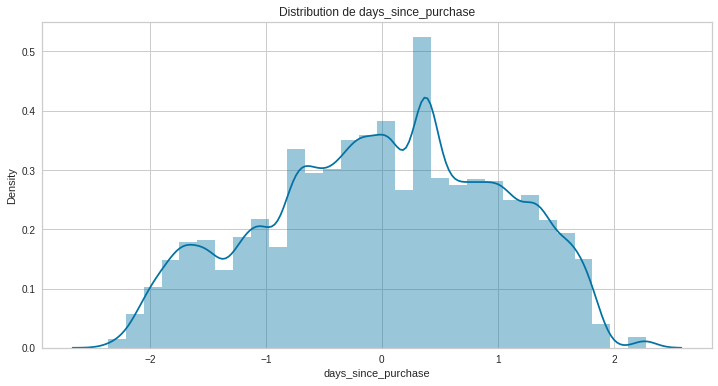

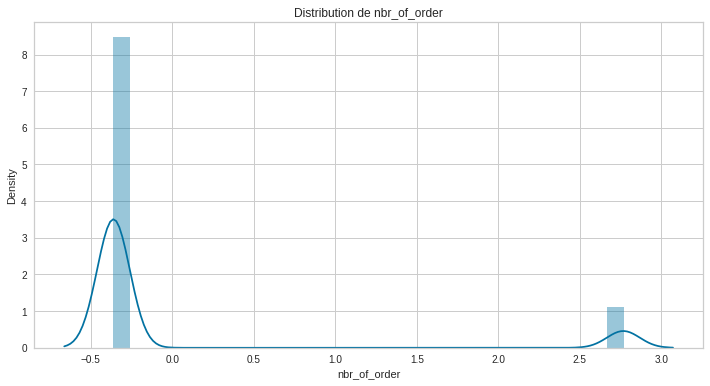

In [ ]:
for column in X_total.select_dtypes(['int64', 'float64']).columns:
  if (X_total.select_dtypes(['int64', 'float64'])[column].nunique() > 1):
    plt.figure(figsize=(12,6))
    plt.title('Distribution de ' + column)
    sns.distplot(X_total[column].dropna(), bins=30)

###### conclusion

fait bien ressortir une distribution normale concernant le prix et days_since_purchase 

##### Nous allons effectuer une reduction de l'échantillon 

In [ ]:
X = X_total.sample(10000,random_state=0)

X = X.reset_index(drop=True)

In [ ]:
X

,price,days_since_purchase,nbr_of_order,R,F,M,RFMClass,RFM_Score
0,-1.140298,0.137650,-0.361340,3,1,1,311,5
1,1.126583,-0.429617,-0.361340,2,1,4,214,7
2,-0.402074,-1.526465,-0.361340,1,1,2,112,4
3,0.416036,-0.838622,-0.361340,1,1,3,113,5
4,-0.714007,-0.794113,-0.361340,1,1,1,111,3
...,...,...,...,...,...,...,...,...
9995,1.581808,1.875241,-0.361340,4,1,4,414,9
9996,0.313851,-1.644377,2.766526,1,4,3,143,8
9997,-0.091422,-0.199901,2.766526,2,4,2,242,8
9998,2.655298,-0.193029,-0.361340,2,1,4,214,7


##### Nous effectuons une visualisation en 3D

In [ ]:
import plotly.express as px

fig = px.scatter_3d(X, z='nbr_of_order', x='days_since_purchase', y='price',
                    size_max=18,
                    opacity=0.7,
                    #color='petal_length', 
                    #color='RFM_Score'
                    )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

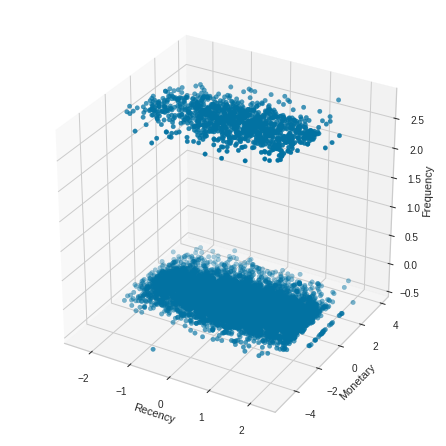

In [ ]:
# axes instance
fig = plt.figure(figsize=(6,6))
ax = Axes3D(fig)

# Data for three-dimensional scattered points
zdata = X['nbr_of_order']
xdata = X['days_since_purchase']
ydata = X['price']

ax.set_xlabel('Recency')
ax.set_ylabel('Monetary')
ax.set_zlabel('Frequency')

ax.scatter3D(xdata, ydata, zdata);

In [ ]:
def circleOfCorrelations(pc_infos, ebouli):
  """ The function below was created specifically for PCA, 
  plot circle of correlation."""
  plt.Circle((0,0),radius=10, color='g', fill=False)
  circle1=plt.Circle((0,0),radius=1, color='g', fill=False)
  fig = plt.figure(figsize=(10,10))
  fig.gca().add_artist(circle1)
  for idx in range(len(pc_infos["PC-0"])):
    x = pc_infos["PC-0"][idx]
    y = pc_infos["PC-1"][idx]
    plt.plot([0.0,x],[0.0,y],'k-')
    plt.plot(x, y, 'rx')
    plt.annotate(pc_infos.index[idx], xy=(x,y))
  plt.xlabel("PC-0 (%s%%)" % str(ebouli[0])[:4].lstrip("0."))
  plt.ylabel("PC-1 (%s%%)" % str(ebouli[1])[:4].lstrip("0."))
  plt.xlim((-1,1))
  plt.ylim((-1,1))
  plt.title("Circle of Correlations")

def myPcaSupport(df):
  """
  The function below was created specifically for PCA, plot circle of correlation
  and eighenvalues 
  """
  fig = plt.figure(figsize=(10, 10))
  # Drop str col
  df = df.select_dtypes(include=['number'])
  # Drop na
  df = df.dropna()
	# Normalize data
  df_norm = (df - df.mean()) / df.std()
	# PCA
  pca = PCA(n_components='mle')
  pca_res = pca.fit_transform(df_norm.values)
  # Ebouli
  ebouli = pd.Series(pca.explained_variance_ratio_)
  ebouli.plot(kind='bar', title="Ebouli des valeurs propres")
  plt.show()
  # Circle of correlations
  coef = np.transpose(pca.components_)
  cols = ['PC-'+str(x) for x in range(len(ebouli))]
  pc_infos = pd.DataFrame(coef, columns=cols, index=df_norm.columns)
  circleOfCorrelations(pc_infos, ebouli)
  plt.show()

def myPCA(df_full, hue_column=0):
  """
  The function below was created specifically for PCA, plot circle of correlation
  and eighenvalues 
  """
  fig = plt.figure(figsize=(10, 10))
  # Drop str col
  df = df_full.select_dtypes(include=['number'])
  # Drop na
  df = df.dropna()
	# Normalize data
  df_norm = (df - df.mean()) / df.std()
	# PCA
  pca = PCA()
  pca_res = pca.fit_transform(df_norm.values)
  # Ebouli
  ebouli = pd.Series(pca.explained_variance_ratio_)
  # Circle of correlations
  coef = np.transpose(pca.components_)
  cols = ['PC-'+str(x) for x in range(len(ebouli))]
  # Plot PCA
  dat = pd.DataFrame(pca_res, columns=cols)
  dat['hue'] = hue_column
  sns.lmplot(x = "PC-0", y = "PC-1", data=dat, hue="hue", fit_reg=False,
            height=8.27, aspect=11.7/8.27, markers='x')
  plt.xlabel("PC-0 (%s%%)" % str(ebouli[0])[:4].lstrip("0."))
  plt.ylabel("PC-1 (%s%%)" % str(ebouli[1])[:4].lstrip("0."))
  plt.title("PCA") 
  plt.show()

def cm_analysis(y_true, y_pred, labels, ymap=None, figsize=(10,10)):
  """
  Generate matrix plot of confusion matrix with pretty annotations.
  args: 
    y_true: true label of the data, with shape (nsamples,)
    y_pred: prediction of the data, with shape (nsamples,)
    filename: filename of figure file to save
    labels: string array, name the order of class labels in the confusion 
            matrix. Use `clf.classes_` if using scikit-learn models.
            with shape (nclass,).
    ymap: dict: any -> string, length == nclass.
          if not None, map the labels & ys to more understandable strings.
          Caution: original y_true, y_pred and labels must align.
    figsize: the size of the figure plotted.
  """
  if ymap is not None:
      y_pred = [ymap[yi] for yi in y_pred]
      y_true = [ymap[yi] for yi in y_true]
      labels = [ymap[yi] for yi in labels]
  cm = confusion_matrix(y_true, y_pred, labels=labels)
  cm_sum = np.sum(cm, axis=1, keepdims=True)
  cm_perc = cm / cm_sum.astype(float) * 100
  annot = np.empty_like(cm).astype(str)
  nrows, ncols = cm.shape
  for i in range(nrows):
      for j in range(ncols):
          c = cm[i, j]
          p = cm_perc[i, j]
          if i == j:
              s = cm_sum[i]
              annot[i, j] = '%.1f%%\n%d/%d' % (p, c, s)
          elif c == 0:
              annot[i, j] = ''
          else:
              annot[i, j] = '%.1f%%\n%d' % (p, c)
  cm = pd.DataFrame(cm_perc, index=labels, columns=labels)
  cm.index.name = 'Actual'
  cm.columns.name = 'Predicted'
  fig, ax = plt.subplots(figsize=figsize)
  sns.heatmap(cm, annot=annot, fmt='', cmap='rocket_r', ax=ax)
  plt.show()


def name_cluster(df):
  """
  take the customer segmentation data frame with kmeans label and
  add a column cluster.
  name_cluster give a name to the cluster
  """
  
  label_data = df.groupby('label_kmeans').mean().reset_index().copy()

  label_data.loc[label_data['nbr_of_order'] == max(
      label_data['nbr_of_order']), 'cluster'] = 'Loyal'

  label_data.loc[label_data['days_since_purchase'] == min(
      label_data['days_since_purchase']), 'cluster'] = 'New'

  label_data.loc[label_data['price'] == max(
      label_data['price']),
      'cluster'] = 'Big'

  label_data.loc[label_data['cluster'].isna(),
                'cluster'] = 'Small'

  df = df.merge(label_data[['label_kmeans', 'cluster']],
                how='left')
  
  return df


def DbscanElbowVisualizer(X, metric='silhouette',
                          list_min_sample=range(3, 10),
                          list_eps=[0.2, 0.3, 0.4]):
  """
  return davies_bouldin score of a dataframe for eps
  and min_sample you want test.
  X the dataframe to fit
  list_min_sample the list of min sample to test
  list_eps the of eps to test
  """ 
  score = {}
  i = 0
  df_score = pd.DataFrame(index=list_min_sample)
  for j in list_eps:
      for k in list_min_sample:
          if metric == 'davies bouldin':
              score[k] = davies_bouldin_score(
                  X = X,
                  labels = DBSCAN(min_samples=k,
                                  eps=j).fit(X).labels_)
          elif metric == 'silhouette':
              score[k] = silhouette_score(
                  X = X,
                  labels = DBSCAN(min_samples=k,
                                  eps=j).fit(X).labels_)
          elif metric == 'k cluster':
              labels = DBSCAN(min_samples=k, eps=j).fit(X).labels_
              score[k] = len(set(labels)) - (1 if -1 in labels else 0)      
      df_score[i] = list(score.values())
      i += 1

  df_score.columns = list_eps
  plt.figure(figsize=(8,6)),
  plt.title(metric + ' score en fonction de min_sample')
  sn.lineplot(data=df_score)

  plt.show()

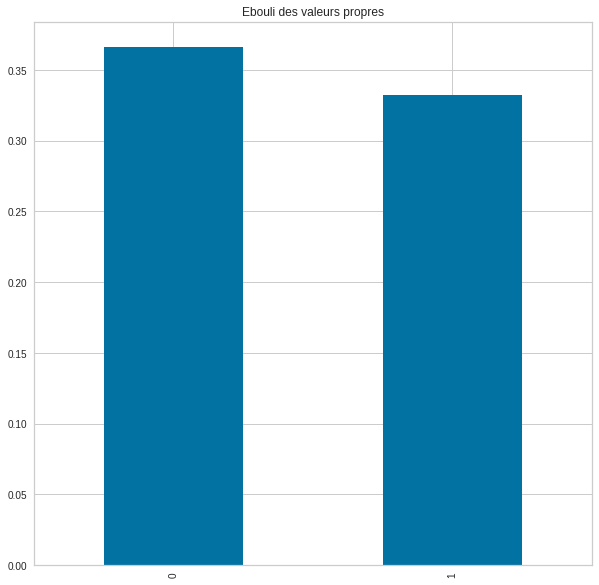

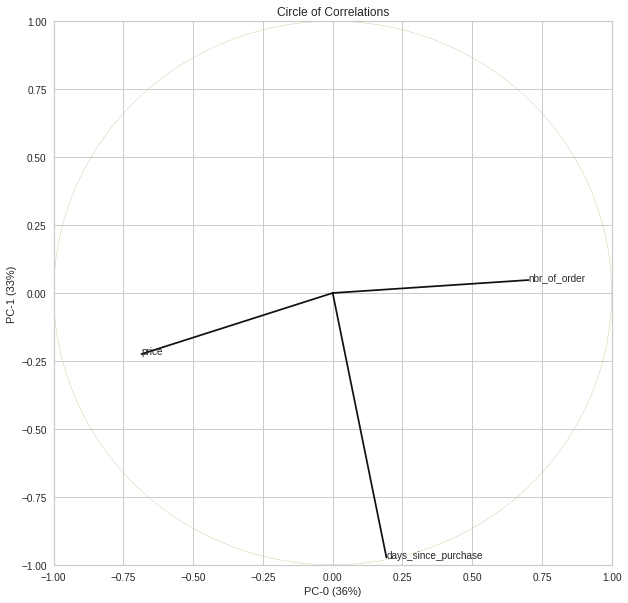

In [ ]:
#reduction par le biais d'un pca
myPcaSupport(X_total)

- F1 : nb order plutot bien correlé 
- F2 : day_since_purchase bien correlé


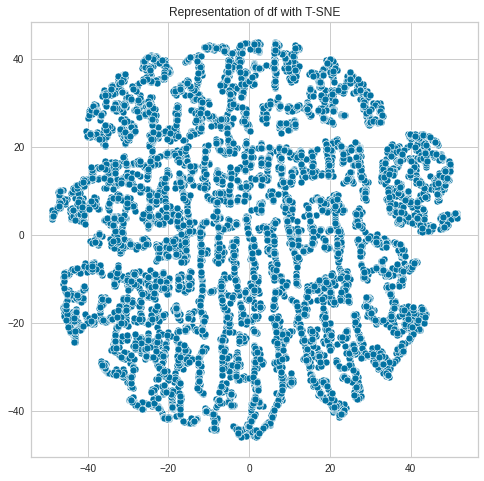

In [ ]:
#visulation complementaire TSNE


tsne = TSNE(n_components=2,
            init='pca',
            n_iter=500,
            random_state=0)
T = tsne.fit_transform(X)

plt.figure(figsize=(8,8))
plt.title('Representation of df with T-SNE')
sns.scatterplot(T[:,0], T[:,1])

In [ ]:
X_total.to_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/preparation_board_segmentation_ok.csv')

Utilisation clustering

In [ ]:
X.isna().sum()

price                  0
days_since_purchase    0
nbr_of_order           0
R                      0
F                      0
M                      0
RFMClass               0
RFM_Score              0
dtype: int64

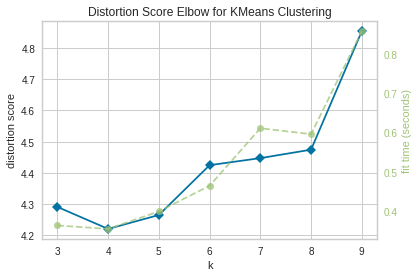

In [ ]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(3,10))

visualizer.fit(X)
visualizer.poof()

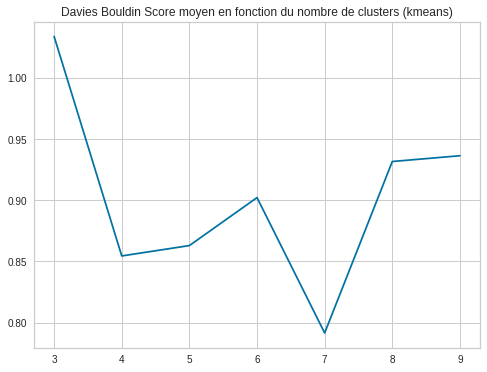

In [ ]:
davies_bouldin_kmeans = {}
for i in range(3, 10):
    davies_bouldin_kmeans[i] = davies_bouldin_score(
        X = X,
        labels = KMeans(n_clusters=i).fit(X).labels_)

plt.figure(figsize=(8,6)),
plt.title('Davies Bouldin Score moyen en fonction du nombre de clusters (kmeans)')
sns.lineplot(x = list(davies_bouldin_kmeans.keys()),
            y = list(davies_bouldin_kmeans.values()))
plt.show()

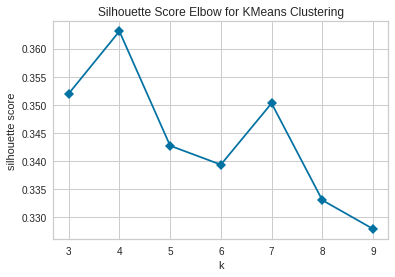

In [ ]:
# Instantiate the clustering model and visualizer 
model = KMeans()
visualizer = KElbowVisualizer(model, k=(3, 10),
                              metric='silhouette', timings=False)

visualizer.fit(X)    # Fit the data to the visualizer
visualizer.poof() 

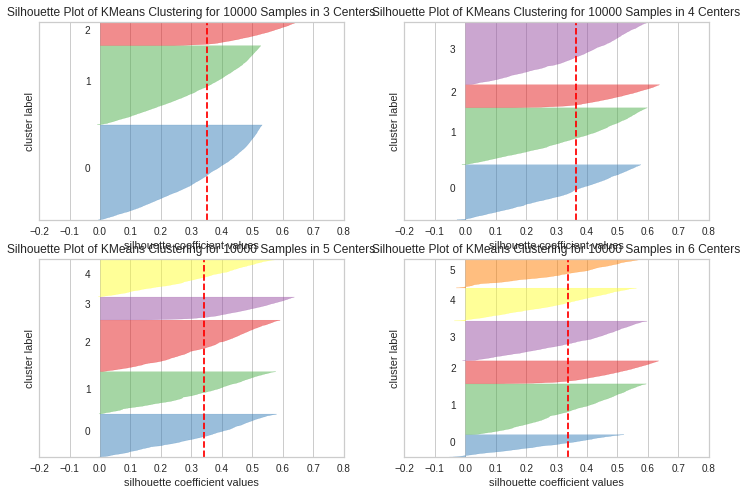

In [ ]:
fig, axes = plt.subplots(2,2,figsize=(12,8))
axes = axes.reshape(4)
for i,k in enumerate(range(3,7)):
  ax = axes[i]
  sil = SilhouetteVisualizer(
      KMeans(n_clusters=k,random_state=0),
      ax=ax,
  )
  sil.fit(X)
  sil.finalize()
  ax.set_xlim(-0.2,0.8)


#model = KMeans()
#visualizer = SilhouetteVisualizer(model)

#visualizer.fit(X)    # Fit the data to the visualizer
#visualizer.poof() 

##### conclustion 

nous décidons de concerver 5 clusters car les groupes semblent plus homogenes que sur 4 apres vérification sur la silhouette

In [ ]:
kmeans = KMeans(n_clusters=5, 
                verbose=1,
                init='k-means++', 
                random_state=0,
                n_jobs=-1).fit(X)

In [ ]:
T = X.copy()

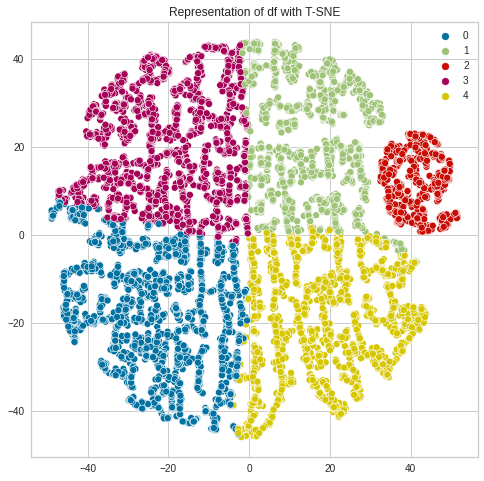

In [ ]:

#Visualiser avec T-SNE

plt.figure(figsize=(8,8))
plt.title('Representation of df with T-SNE')
sns.scatterplot(data=T, x=T[:,0], y=T[:,1], hue=kmeans.labels_,
               palette=sns.color_palette(n_colors=5))

In [ ]:
import matplotlib as mpl 

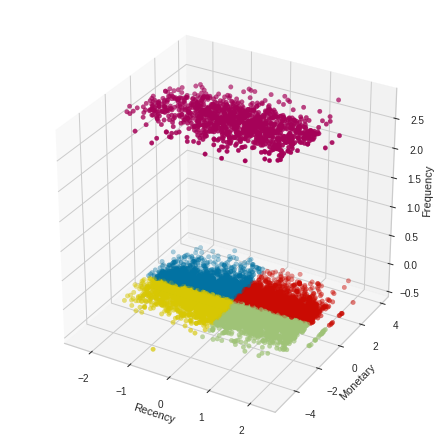

In [ ]:
# axes instance
fig = plt.figure(figsize=(6,6))
ax = Axes3D(fig)

# Data for three-dimensional scattered points
zdata = X['nbr_of_order']
xdata = X['days_since_purchase']
ydata = X['price']

ax.set_xlabel('Recency')
ax.set_ylabel('Monetary')
ax.set_zlabel('Frequency')

ax.scatter3D(xdata, ydata, zdata, c=kmeans.labels_,
             cmap=mpl.colors.ListedColormap(
                 sns.color_palette(n_colors=5).as_hex()));

### Identification des clusters

In [ ]:
labels = kmeans.labels_
print(labels)

[2 3 2 ... 4 1 4]


In [ ]:
listingValue = X.copy()

In [ ]:
# Création d'une variable categorielle afin de classer les prix
listingValue['lvl_price'] = pd.cut(listingValue['price'],bins=[listingValue['price'].min(),40,60,80,listingValue['price'].max()],include_lowest=True)

In [ ]:
# Création d'une variable catégorielle afin de classer le nombre de jour d'achat
listingValue['lvl_purchase'] = pd.cut(listingValue['days_since_purchase'],bins=[listingValue['days_since_purchase'].min(),90,180,360,listingValue['days_since_purchase'].max()],include_lowest=True)

In [ ]:
listingValue

,price,days_since_purchase,nbr_of_order,lvl_price,lvl_purchase
0,385.00,224,2,"(80.0, 1290.0]","(180.0, 360.0]"
1,79.90,117,1,"(60.0, 80.0]","(90.0, 180.0]"
2,64.99,30,2,"(60.0, 80.0]","(-0.001, 90.0]"
3,349.90,147,1,"(80.0, 1290.0]","(90.0, 180.0]"
4,19.99,332,2,"(0.849, 40.0]","(180.0, 360.0]"
...,...,...,...,...,...
9995,31.89,63,1,"(0.849, 40.0]","(-0.001, 90.0]"
9996,55.20,411,1,"(40.0, 60.0]","(360.0, 694.0]"
9997,49.90,317,1,"(40.0, 60.0]","(180.0, 360.0]"
9998,9.99,164,1,"(0.849, 40.0]","(90.0, 180.0]"


In [ ]:
mytab3 = pd.crosstab(labels,[listingValue.lvl_price,listingValue.nbr_of_order,listingValue.lvl_purchase])

In [ ]:
mytab3

lvl_price     (0.849, 40.0]                ... (80.0, 1290.0]               
nbr_of_order              1                ...              2              3
lvl_purchase (-0.001, 90.0] (90.0, 180.0]  ... (360.0, 694.0] (-0.001, 90.0]
row_0                                      ...                              
0                         0             0  ...              0              0
1                       422           480  ...              0              0
2                         0             0  ...             42              1
3                         0             0  ...              0              0
4                         0             0  ...              0              0

[5 rows x 43 columns]

In [ ]:
segement1 = mytab3.iloc[0,:]

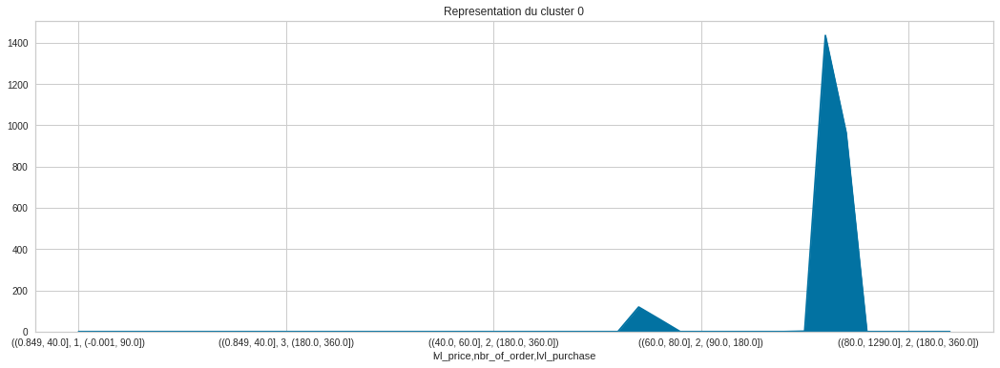

In [ ]:
plt.figure(figsize=(18,6))
plt.title('Representation du cluster 0')
segement1.plot.area(x='lvl_price',y='lvl_purchase')

In [ ]:
segement2 = mytab3.iloc[1,:]

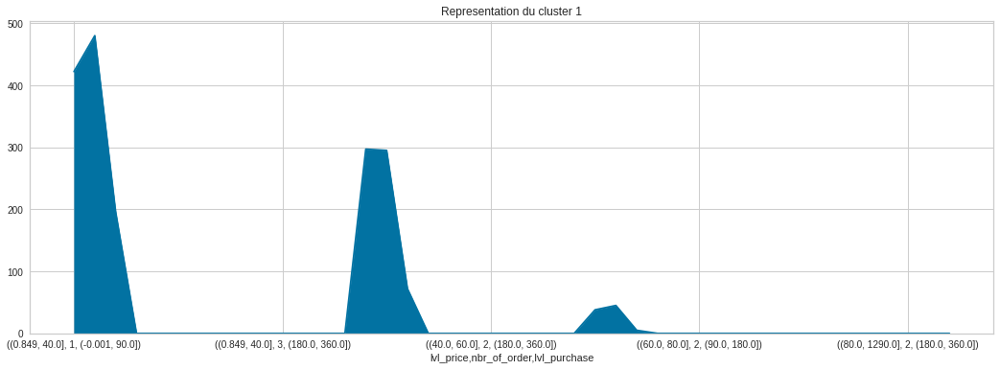

In [ ]:
plt.figure(figsize=(18,6))
plt.title('Representation du cluster 1')
segement2.plot.area(x='lvl_price',y='lvl_purchase')

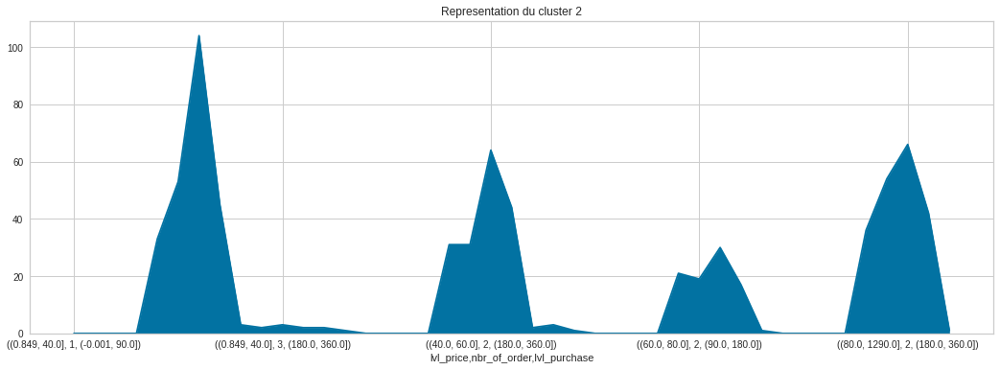

In [ ]:
segement3 = mytab3.iloc[2,:]
plt.figure(figsize=(18,6))
plt.title('Representation du cluster 2')
segement3.plot.area(x='lvl_price',y='lvl_purchase')

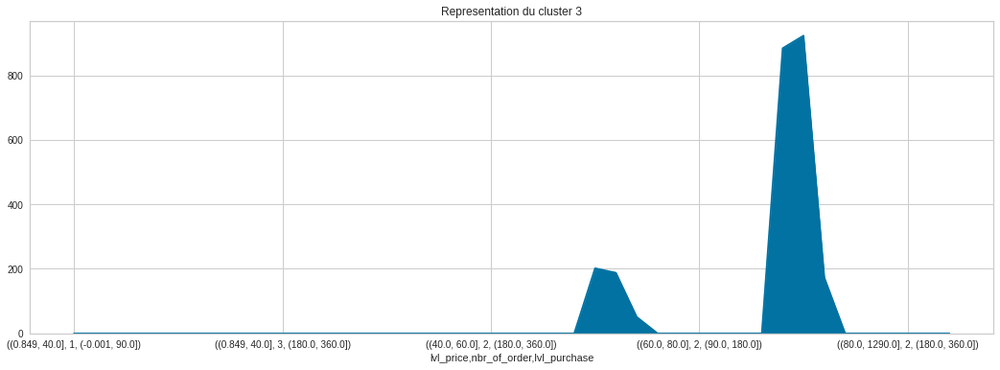

In [ ]:
segement4 = mytab3.iloc[3,:]
plt.figure(figsize=(18,6))
plt.title('Representation du cluster 3')
segement4.plot.area(x='lvl_price',y='lvl_purchase')

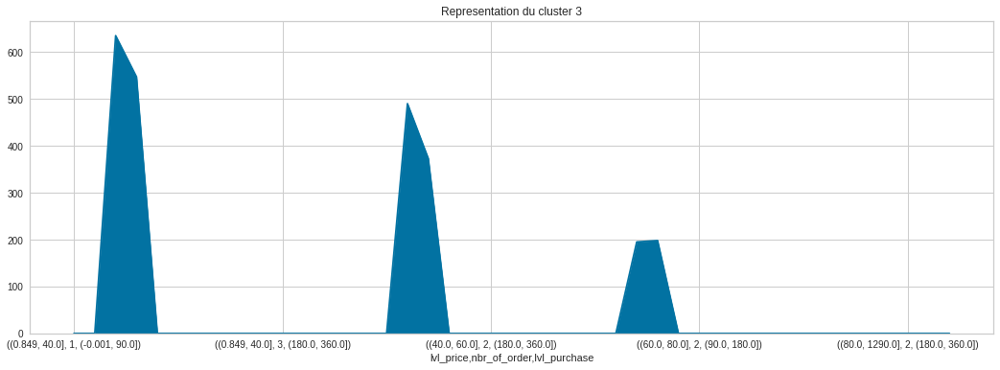

In [ ]:
segement3 = mytab3.iloc[4,:]
plt.figure(figsize=(18,6))
plt.title('Representation du cluster 3')
segement3.plot.area(x='lvl_price',y='lvl_purchase')

##### Conclusion des clusters réalisés

- Cluster 0 : le montant des achats est en moyenne supèrieur a 180 euro, le nombre de jour de la commande est a plus de 180 jours 

- Cluster 1 : le montant des achats est en moyenne de 50 euro, le nombre de jour de la commande est plutot compris entre 6 mois et un an

- Cluster 2 : le montant des achats est en moyenne de 70 euro, le nombre de jour de la commande est plutot comprise entre 90 et 360 jr

- Cluster 3 : le montant des achats est en moyenne supèrieur a 180 euro, le nombre de jour de la commande est a plus de 180 jours. nombre de commande etant au minimum 2

- Cluster 4 : le montant des achats est en moyenne de 40 euro, le nombre de jour de la commande est d'environs 90 jours.






#### DBSCAN

Nous utilisons ici une seconde approche afin de voir si nous obtenons les même resultats concernant nos clusters



In [ ]:
def DbscanElbowVisualizer(X, metric='silhouette',
                          list_min_sample=range(3, 10),
                          list_eps=[0.2, 0.3, 0.4]):
  """
  return davies_bouldin score of a dataframe for eps
  and min_sample you want test.
  X the dataframe to fit
  list_min_sample the list of min sample to test
  list_eps the of eps to test
  """ 
  score = {}
  i = 0
  df_score = pd.DataFrame(index=list_min_sample)
  for j in list_eps:
      for k in list_min_sample:
          if metric == 'davies bouldin':
              score[k] = davies_bouldin_score(
                  X = X,
                  labels = DBSCAN(min_samples=k,
                                  eps=j).fit(X).labels_)
          elif metric == 'silhouette':
              score[k] = silhouette_score(
                  X = X,
                  labels = DBSCAN(min_samples=k,
                                  eps=j).fit(X).labels_)
          elif metric == 'k cluster':
              labels = DBSCAN(min_samples=k, eps=j).fit(X).labels_
              score[k] = len(set(labels)) - (1 if -1 in labels else 0)      
      df_score[i] = list(score.values())
      i += 1

  df_score.columns = list_eps
  plt.figure(figsize=(8,6)),
  plt.title(metric + ' score en fonction de min_sample')
  sns.lineplot(data=df_score)

  plt.show()

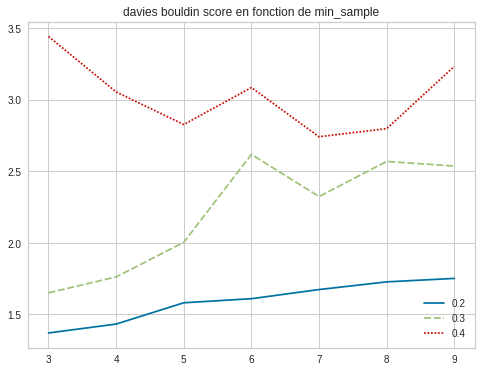

In [ ]:
DbscanElbowVisualizer(X, 'davies bouldin', range(3, 10), [0.2, 0.3, 0.4])

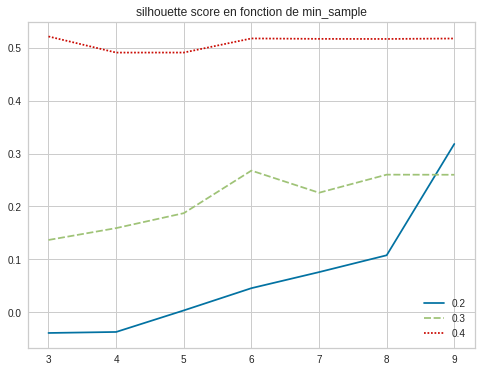

In [ ]:
DbscanElbowVisualizer(X, 'silhouette', range(3, 10), [0.2, 0.3, 0.4])

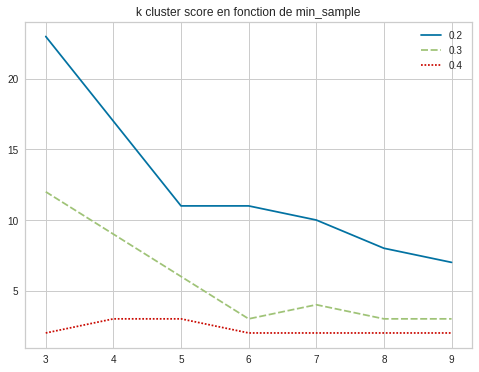

In [ ]:
DbscanElbowVisualizer(X, 'k cluster', range(3, 10), [0.2, 0.3, 0.4])

In [ ]:
dbs = DBSCAN(eps = 0.2, 
             min_samples=7,
             n_jobs=-1).fit(X.copy())

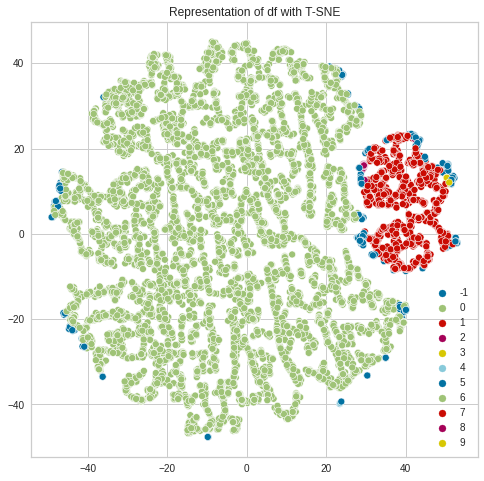

In [ ]:
plt.figure(figsize=(8,8))
plt.title('Representation of df with T-SNE')
sns.scatterplot(data=T, x=T[:,0], y=T[:,1], hue=dbs.labels_,
               palette=sns.color_palette(n_colors=len(set(dbs.labels_))))

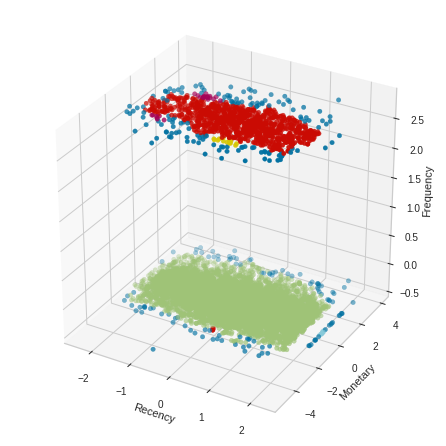

In [ ]:
# axes instance
fig = plt.figure(figsize=(6,6))
ax = Axes3D(fig)

# Data for three-dimensional scattered points
zdata = X['nbr_of_order']
xdata = X['days_since_purchase']
ydata = X['price']

ax.set_xlabel('Recency')
ax.set_ylabel('Monetary')
ax.set_zlabel('Frequency')

ax.scatter3D(xdata, ydata, zdata, c=dbs.labels_,
             cmap=mpl.colors.ListedColormap(
                 sns.color_palette(n_colors=len(set(dbs.labels_))).as_hex()))

#### Conclusion DBSCAN

- Nous constatons que les clusters ne ressorte pas de manière heterogene et de manière equilibré.

sur l'analyse des groupe :
Cela indiquerait par exmple un client ayant dépensé récemment appartient au meme groupe que celui ayant fait tres peu de transaction, il en va de meme des montants.
Une différenciation importante est faite sur le groupe dès l'instant ou celui ci a fait plusieurs transaction)


#### Conclusion de notre analyse
---

Ainsi, kmean est bien plus prometteur que dbscan, 

nous pouvons grace au resultat emettre une segmentation cohérente dans le cadre d'une future opération markéting.

Groupe cluster | signification | description | Catégorie de segmentation
----------------|---------------- |---------------- |------------|
cluster 0 |  clientèle Haut de Gamme non actif | achat a plus de 360 jr mais montant important| **Clientele à fort Potentielle**
cluster 1 |  clientèle grand public | achat de 50 euro env periode recente | **Clientèle à ne pas perdre** 
cluster 2 |  clientèle active| achat en myenne 70 Euro entre de 90 360 | **Champions**
cluster 3 |  clientèle active avec panier moyen 180 euro | clientèle ayant passé plus de 2 commandes | **Clientèle loyale**
cluster 4 |  clientèle grand public plutot active | achat de 40 euro environ | **Clientèle à suivre**





#### Test de stabilité


Nous allons effectuer un test afin de caluler la note ARI du regroupement effectué selon les périodes choisis

In [96]:
pd.set_option('display.max_column',163)
pd.set_option('display.max_row',163)
table_segmentation = pd.read_csv('/content/drive/MyDrive/OC_Aurelien_MIMOUNI/P05_Aurélien_MIMOUNI/tableau_bord_agregeARITest.csv',parse_dates=['first_purchase_date','order_estimated_delivery_date','order_purchase_timestamp','shipping_limit_date'],dayfirst=True,delimiter=',')

In [106]:
#table_segmentation.drop('Unnamed: 0',axis=1,inplace=True)

In [105]:
df = table_segmentation.copy()

In [149]:
start = '2016'
duration = 9999
# I transform start in datetime64
start = np.datetime64(start, 's')

# I transform duration in timedelta64
duration = np.timedelta64(duration, 'D')

In [150]:
# I keep only orders for the period given in the parameters
df = df.loc[df['order_purchase_timestamp'] > start]
end = start + duration
df = df.loc[df['order_purchase_timestamp'] < end]

In [151]:
df

,,,,customer_city,customer_state,customer_id,price,order_time,estimated_order_time,avg_basket_size,order_purchase_timestamp,review_score,geolocation_lat,geolocation_lng,estimated_order_time_error,freight_value,avg_volume
customer_unique_id,favourite_categ,payment_type,payment_installments,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,bed_bath_table,credit_card,8.0,cajamar,SP,1,129.90,6.0,10.0,1.0,2018-05-10 10:56:27,5.0,-23.335331,-46.828647,-4.0,12.00,7.616
0000b849f77a49e4a4ce2b2a4ca5be3f,health_beauty,credit_card,1.0,osasco,SP,1,18.90,3.0,7.0,1.0,2018-05-07 11:11:27,4.0,-23.567395,-46.792957,-4.0,8.29,5.148
0004bd2a26a76fe21f786e4fbd80607f,garden_tools,credit_card,8.0,sao paulo,SP,1,154.00,1.0,13.0,1.0,2018-04-05 19:33:16,4.0,-23.511323,-46.693146,-12.0,12.98,8.241
00050ab1314c0e55a6ca13cf7181fecf,telephony,boleto,1.0,campinas,SP,1,27.99,6.0,18.0,1.0,2018-04-20 12:57:23,4.0,-22.819059,-47.093379,-12.0,7.39,0.816
00053a61a98854899e70ed204dd4bafe,sports_leisure,credit_card,3.0,curitiba,PR,2,191.00,16.0,25.0,2.0,2018-02-28 11:15:41,1.0,-25.429683,-49.274635,-9.0,37.18,15.059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fff2ae16b99c6f3c785f0e052f2a9cfb,office_furniture,credit_card,8.0,rio de janeiro,RJ,1,129.94,21.0,41.0,1.0,2018-04-20 11:03:47,5.0,-22.915540,-43.542340,-20.0,70.96,46.056
fff3e1d7bc75f11dc7670619b2e61840,computers_accessories,debit_card,1.0,teresina,PI,1,54.85,10.0,18.0,1.0,2018-07-20 13:47:30,5.0,-5.046858,-42.812278,-8.0,27.66,1.920
fff5eb4918b2bf4b2da476788d42051c,signaling_and_security,boleto,1.0,campina grande,PB,6,175.00,13.0,29.0,6.0,2018-07-02 16:39:59,5.0,-7.223609,-35.875888,-16.0,1794.96,136.080


In [112]:
# I add product id to merge product category name
 

df.fillna(value={'product_category_name_english': 'other'}, inplace=True)

df_categ = df.groupby(
    'customer_unique_id').first()['product_category_name_english'].reset_index()

df_categ = df_categ.rename(
    columns={'product_category_name_english': 'favourite_categ'})

df = pd.merge(df,
              df_categ,
              how='left')

In [122]:

basket_size_order = df.groupby(
    'order_id').count()['product_id'].reset_index()

basket_size_order = basket_size_order.rename(
    columns={'product_id': 'avg_basket_size'})

df = pd.merge(df,
              basket_size_order,
              how='left') 

In [119]:

df.fillna(value={'payment_type': 'credit_card',
                          'payment_installments': 1}, inplace=True)

df_payment = df.groupby(
    'customer_unique_id').first()[['payment_type',
                                    'payment_installments']].reset_index()

df = pd.merge(df,
              df_payment,
              how='left') 

In [125]:
# I add average order estimated time
df['estimated_order_time'] = df['order_estimated_delivery_date'] - \
                              df['order_purchase_timestamp']

df['estimated_order_time'] = df['estimated_order_time'].apply(
    lambda x: x.days)

In [128]:
# I add estimated_order_time_error
df['estimated_order_time_error'] = df['order_time'] - (
    df['estimated_order_time'])

In [129]:
  # Aggregation
dict_agg = {'customer_city': 'last',
            'customer_state': 'last',
            'customer_id': 'count',
            'price': 'mean',
            'order_time': 'mean',
            'estimated_order_time': 'mean',
            'avg_basket_size': 'mean',
            'order_purchase_timestamp': 'max',
            'review_score': 'mean',
            'geolocation_lat': 'mean',
            'geolocation_lng': 'mean',
            'estimated_order_time_error': 'mean',
            'freight_value': 'sum',
            'avg_volume': 'mean'}


In [130]:
df = df.groupby(['customer_unique_id', 'favourite_categ',
                     'payment_type', 'payment_installments']).agg(dict_agg)

In [131]:
df

,,,,customer_city,customer_state,customer_id,price,order_time,estimated_order_time,avg_basket_size,order_purchase_timestamp,review_score,geolocation_lat,geolocation_lng,estimated_order_time_error,freight_value,avg_volume
customer_unique_id,favourite_categ,payment_type,payment_installments,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,bed_bath_table,credit_card,8.0,cajamar,SP,1,129.90,6.0,10.0,1.0,2018-05-10 10:56:27,5.0,-23.335331,-46.828647,-4.0,12.00,7.616
0000b849f77a49e4a4ce2b2a4ca5be3f,health_beauty,credit_card,1.0,osasco,SP,1,18.90,3.0,7.0,1.0,2018-05-07 11:11:27,4.0,-23.567395,-46.792957,-4.0,8.29,5.148
0000f46a3911fa3c0805444483337064,stationery,credit_card,8.0,sao jose,SC,1,69.00,25.0,27.0,1.0,2017-03-10 21:05:03,3.0,-27.543787,-48.625680,-2.0,17.22,43.750
0000f6ccb0745a6a4b88665a16c9f078,telephony,credit_card,4.0,belem,PA,1,25.99,20.0,31.0,1.0,2017-10-12 20:29:41,4.0,-1.311011,-48.482884,-11.0,17.63,1.045
0004aac84e0df4da2b147fca70cf8255,telephony,credit_card,6.0,sorocaba,SP,1,180.00,13.0,20.0,1.0,2017-11-14 19:45:42,5.0,-23.504368,-47.466156,-7.0,16.89,0.528
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,health_beauty,credit_card,10.0,sanharo,PE,2,785.00,27.0,54.0,2.0,2017-06-08 21:00:36,5.0,-8.363166,-36.559088,-27.0,497.42,251.625
fffea47cd6d3cc0a88bd621562a9d061,baby,credit_card,1.0,feira de santana,BA,1,64.89,30.0,32.0,1.0,2017-12-10 20:07:56,4.0,-12.221792,-38.962517,-2.0,19.69,32.076
ffff371b4d645b6ecea244b27531430a,auto,credit_card,1.0,sinop,MT,1,89.90,14.0,44.0,1.0,2017-02-07 15:49:16,5.0,-11.829317,-55.496443,-30.0,22.56,3.315
